[If you would like a detailed explanation of this project, please refer to the Medium article below.](https://medium.com/@ai.omar.rehan/building-a-complete-audio-classification-pipeline-using-deep-learning-from-raw-audio-to-mel-9894bd438d85?postPublishedType=initial)


# **Import Dependecies**

In [ ]:
!pip install audiomentations -q
!pip install noisereduce -q

import warnings
warnings.filterwarnings('ignore')

import os
import numpy as np
import pandas as pd
import hashlib
import re
import random
import shutil
import noisereduce as nr
from matplotlib import patches
import librosa
import glob
import zipfile
import seaborn as sns
import uuid
import matplotlib.image as mpimg
import tensorflow as tf
import audiomentations
import matplotlib.pyplot as plt
import soundfile as sf
import librosa.display
from google.colab import files
from google.colab import drive
from tqdm import tqdm
from pathlib import Path
from collections import Counter
from audiomentations import Compose, AddGaussianNoise, TimeStretch, PitchShift, Shift
from IPython.display import Audio
from PIL import Image, ImageStat, UnidentifiedImageError
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPooling2D,Dropout, Flatten, Dense
from tensorflow.keras import layers
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tensorflow.keras import Input
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve, precision_score, recall_score, f1_score, precision_recall_fscore_support, auc

# If our version is <0.30.0, we'll use min_fraction and max_fraction in augmentation "audiomentations"
# If our version is >=0.30.0, we'll use min_shift and max_shift in augmentation "audiomentations"
print(audiomentations.__version__)
print(tf.__version__)

# np.complex = np.complex128  # fix for librosa compatibility

0.43.1
2.19.0


In [ ]:
drive.mount('/content/drive')
zip_path = '/content/drive/MyDrive/Audio Dataset.zip'
extract_to = '/content/my_data'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

Mounted at /content/drive


# **Convert the Dataset to a Data Frame**

In [ ]:
audio_extensions = {".wav", ".mp3", ".ogg"}
paths = [(path.parts[-2], path.name, str(path)) for path in Path(extract_to).rglob('*.*') if path.suffix.lower() in audio_extensions]

df = pd.DataFrame(paths, columns = ['class', 'image', 'full_path'])
df = df.sort_values('class', ascending = True)
df.reset_index(drop = True, inplace = True)
df

,class,image,full_path
0,Baby cry,3-152007-B.ogg,/content/my_data/Audio Dataset/Baby cry/3-1520...
1,Baby cry,1-211527-B.ogg,/content/my_data/Audio Dataset/Baby cry/1-2115...
2,Baby cry,4-167077-B.ogg,/content/my_data/Audio Dataset/Baby cry/4-1670...
3,Baby cry,1-187207-A.ogg,/content/my_data/Audio Dataset/Baby cry/1-1872...
4,Baby cry,3-151081-B.ogg,/content/my_data/Audio Dataset/Baby cry/3-1510...
...,...,...,...
515,Sea waves,2-132157-B.ogg,/content/my_data/Audio Dataset/Sea waves/2-132...
516,Sea waves,5-219379-C.ogg,/content/my_data/Audio Dataset/Sea waves/5-219...
517,Sea waves,4-204618-A.ogg,/content/my_data/Audio Dataset/Sea waves/4-204...
518,Sea waves,1-28135-A.ogg,/content/my_data/Audio Dataset/Sea waves/1-281...


# **EDA Process for Audio Dataset**

In [ ]:
# Start with your dataframe
df = pd.DataFrame(paths, columns=['class', 'filename', 'full_path'])
df = df.sort_values('class').reset_index(drop=True)

# Add duration and sample_rate columns
durations = []
sample_rates = []

for path in df['full_path']:
    y, sr = librosa.load(path, sr=None)
    durations.append(librosa.get_duration(y=y, sr=sr))
    sample_rates.append(sr)

df['duration'] = durations
df['sample_rate'] = sample_rates

In [ ]:
# Check distribution of durations
df['duration'].describe()

,duration
count,520.000000
mean,5.008255
std,0.144807
min,3.644082
25%,5.000998
50%,5.000998
75%,5.000998
max,7.240272


In [ ]:
class_count = df['class'].value_counts()
for cls, count in class_count.items():
    print(f'Class: {cls}, Count: {count} audios')

print(f"\nTotal dataset size is: {len(df)} audios")
print(f"Number of classes: {df['class'].nunique()} classes")

Class: Baby cry, Count: 40 audios
Class: Chainsaw, Count: 40 audios
Class: Clock tick, Count: 40 audios
Class: Cow, Count: 40 audios
Class: Dog, Count: 40 audios
Class: Fire crackling, Count: 40 audios
Class: Frog, Count: 40 audios
Class: Helicopter, Count: 40 audios
Class: Person sneeze, Count: 40 audios
Class: Pig, Count: 40 audios
Class: Rain, Count: 40 audios
Class: Rooster, Count: 40 audios
Class: Sea waves, Count: 40 audios

Total dataset size is: 520 audios
Number of classes: 13 classes


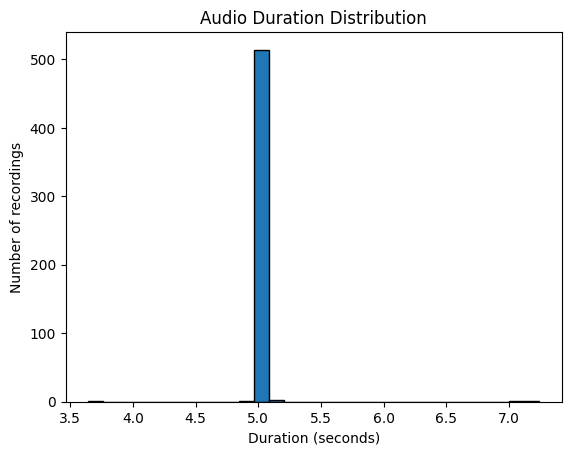

In [ ]:
plt.hist(df['duration'], bins=30, edgecolor='black')
plt.xlabel("Duration (seconds)")
plt.ylabel("Number of recordings")
plt.title("Audio Duration Distribution")
plt.show()

In [ ]:
# Extract extension from filename
df['extension'] = df['filename'].apply(lambda x: x.split('.')[-1].lower())

# Count how many files for each extension
df['extension'].value_counts()

,count
extension,
ogg,520


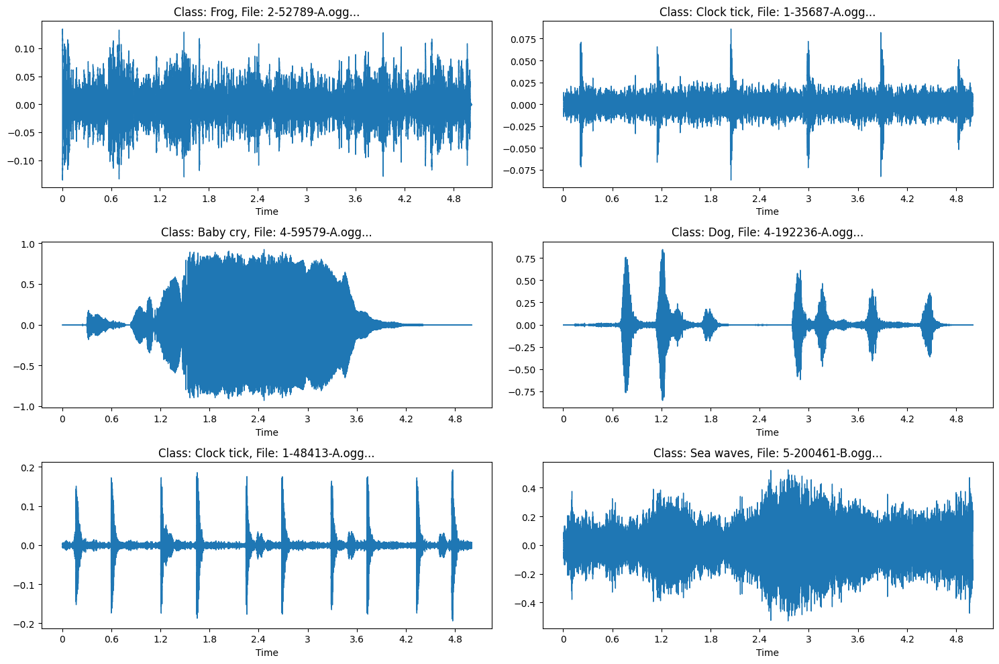

In [ ]:
# Pick random samples from the dataframe
samples = df.sample(6, random_state=42)  # 6 random files

plt.figure(figsize=(15, 10))

for i, row in enumerate(samples.to_dict(orient="records"), 1):
    y, sr = librosa.load(row["full_path"], sr=None)

    plt.subplot(3, 2, i)  # 3 rows × 2 cols
    librosa.display.waveshow(y, sr=sr)

    plt.title(f"Class: {row['class']}, File: {row['filename'][:25]}...")

plt.tight_layout()
plt.show()

In [ ]:
# Compute max amplitude for each file
df['max_amplitude'] = df['full_path'].apply(lambda path: np.abs(librosa.load(path, sr=None)[0]).max())

# Summary statistics
print(df['max_amplitude'].describe())

# Show worst cases
print("\nTop 5 loudest files:")
print(df.sort_values('max_amplitude', ascending=False).head())

print("\nTop 5 quietest files:")
print(df.sort_values('max_amplitude').head())

count    520.000000
mean       0.794865
std        0.228571
min        0.086404
25%        0.688016
50%        0.876117
75%        0.965074
max        1.067162
Name: max_amplitude, dtype: float64

Top 5 loudest files:
             class        filename  \
338  Person sneeze  4-167642-A.ogg   
370            Pig  3-253084-D.ogg   
354  Person sneeze  3-144692-A.ogg   
396            Pig  2-158746-B.ogg   
157            Cow  2-103424-A.ogg   

                                             full_path  duration  sample_rate  \
338  /content/my_data/Audio Dataset/Person sneeze/4...  5.000998        44100   
370  /content/my_data/Audio Dataset/Pig/3-253084-D.ogg  5.003991        44100   
354  /content/my_data/Audio Dataset/Person sneeze/3...  5.000998        44100   
396  /content/my_data/Audio Dataset/Pig/2-158746-B.ogg  5.017324        44100   
157  /content/my_data/Audio Dataset/Cow/2-103424-A.ogg  5.019864        44100   

    extension  max_amplitude  
338       ogg       1.067162  
370 

In [ ]:
def normalize_and_save(path):
    # Load audio
    y, sr = librosa.load(path, sr=None)

    # Normalize
    peak = np.abs(y).max()
    if peak > 0:
        y = y / peak * 0.99  # scale safely below clipping

    # Overwrite file with normalized audio
    sf.write(path, y, sr)

# Apply to all files
for path in df['full_path']:
    normalize_and_save(path)

print("All audio files normalized in-place.")

All audio files normalized in-place.


In [ ]:
df['max_amplitude_after'] = df['full_path'].apply(lambda path: np.abs(librosa.load(path, sr=None)[0]).max())

print(df['max_amplitude_after'].describe())

count    520.000000
mean       0.992751
std        0.071791
min        0.780095
25%        0.953158
50%        0.984079
75%        1.019228
max        1.357823
Name: max_amplitude_after, dtype: float64


In [ ]:
df[['max_amplitude', 'max_amplitude_after']].head(10)

,max_amplitude,max_amplitude_after
0,0.959810,1.038734
1,0.772084,0.993041
2,0.933360,0.986875
3,0.942807,0.991961
4,0.923268,0.986109
5,0.383392,0.992344
6,0.928349,1.017660
7,0.892508,0.988948
8,0.895080,0.985381
9,0.944800,0.987219


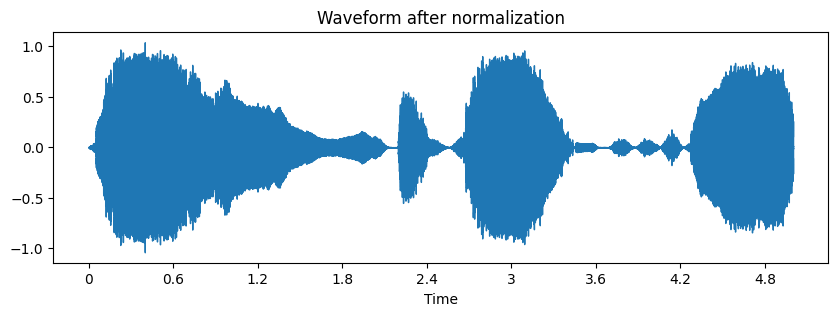

In [ ]:
y, sr = librosa.load(df['full_path'].iloc[0], sr=None)
plt.figure(figsize=(10,3))
librosa.display.waveshow(y, sr=sr)
plt.title("Waveform after normalization")
plt.show()

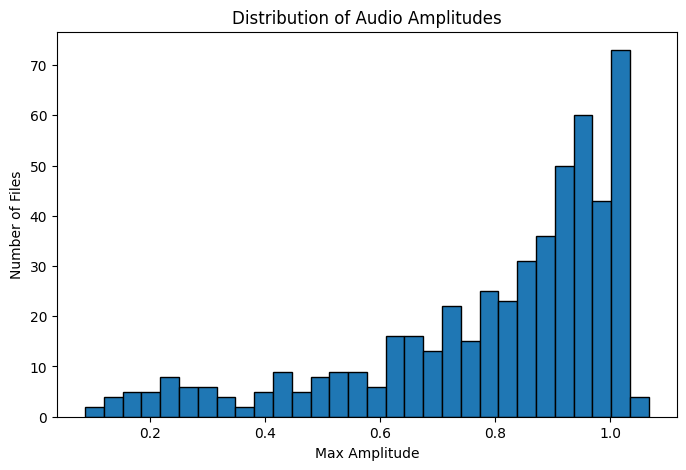

In [ ]:
plt.figure(figsize=(8,5))
plt.hist(df['max_amplitude'], bins=30, edgecolor='k')
plt.xlabel("Max Amplitude")
plt.ylabel("Number of Files")
plt.title("Distribution of Audio Amplitudes")
plt.show()

In [ ]:
# Compute min and max amplitude per file
def get_min_max(path):
    y, sr = librosa.load(path, sr=None)
    return y.min(), y.max()

df[['min_amplitude', 'max_amplitude']] = df['full_path'].apply(
    lambda path: pd.Series(get_min_max(path))
)

print(df[['min_amplitude', 'max_amplitude']].describe())

       min_amplitude  max_amplitude
count     520.000000     520.000000
mean       -0.944438       0.933473
std         0.117165       0.122726
min        -1.356192       0.351628
25%        -1.003650       0.875166
50%        -0.961256       0.951758
75%        -0.890625       1.002884
max        -0.403972       1.357823


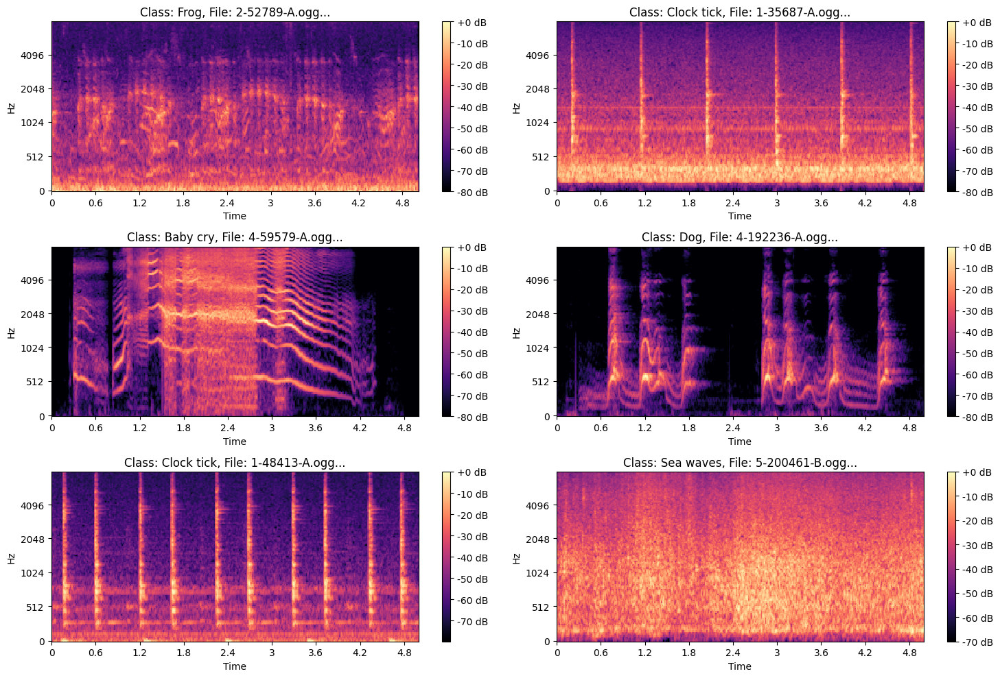

In [ ]:
# Pick random 6 samples
samples = df.sample(6, random_state=42).to_dict(orient="records")

plt.figure(figsize=(15, 10))

for i, row in enumerate(samples, 1):
    # Load audio
    y, sr = librosa.load(row["full_path"], sr=None)

    # Generate Mel spectrogram
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    S_dB = librosa.power_to_db(S, ref=np.max)  # convert to dB scale

    # Plot
    plt.subplot(3, 2, i)
    librosa.display.specshow(S_dB, sr=sr, x_axis="time", y_axis="mel", fmax=8000)
    plt.colorbar(format="%+2.0f dB")
    plt.title(f"Class: {row['class']}, File: {row['filename'][:20]}...")

plt.tight_layout()
plt.show()

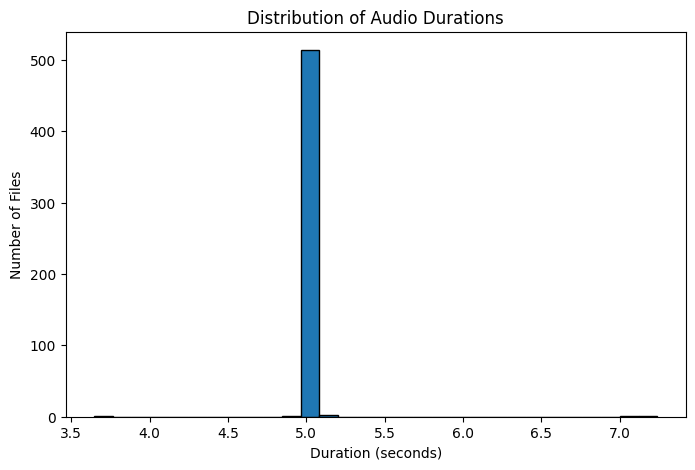

In [ ]:
# Compute duration per file
df['duration'] = df['full_path'].apply(lambda path: librosa.get_duration(path=path))

plt.figure(figsize=(8,5))
plt.hist(df['duration'], bins=30, edgecolor='k')
plt.xlabel("Duration (seconds)")
plt.ylabel("Number of Files")
plt.title("Distribution of Audio Durations")
plt.show()

In [ ]:
df['mean_amplitude'] = df['full_path'].apply(lambda path: librosa.load(path, sr=None)[0].mean())

print("Amplitude stats (mean per file):")
print(df['mean_amplitude'].describe())
print("\nVariance of amplitudes (file-level):")
print(df['mean_amplitude'].var())

Amplitude stats (mean per file):
count    520.000000
mean      -0.000028
std        0.000766
min       -0.006844
25%       -0.000056
50%       -0.000001
75%        0.000025
max        0.013461
Name: mean_amplitude, dtype: float64

Variance of amplitudes (file-level):
5.869631536370434e-07


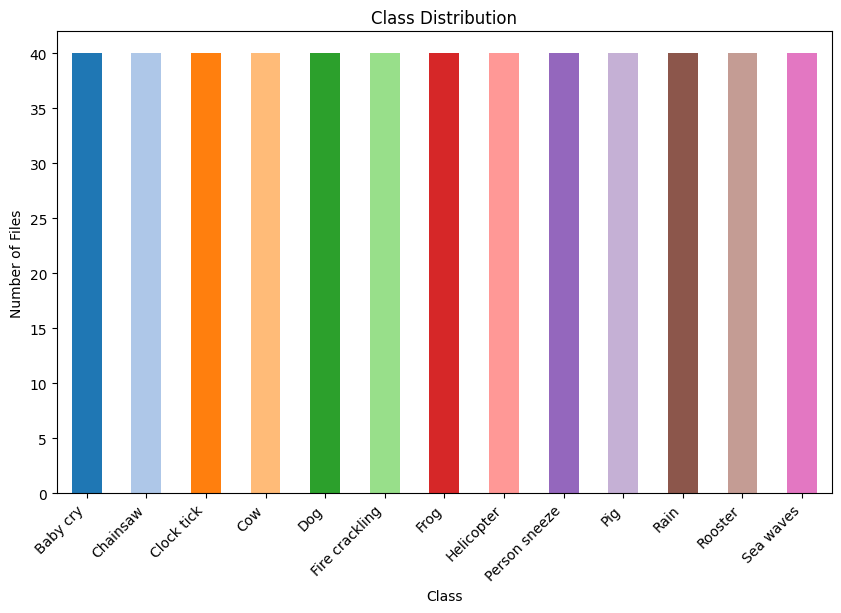


Class counts:
 class
Baby cry          40
Chainsaw          40
Clock tick        40
Cow               40
Dog               40
Fire crackling    40
Frog              40
Helicopter        40
Person sneeze     40
Pig               40
Rain              40
Rooster           40
Sea waves         40
Name: count, dtype: int64


In [ ]:
# Count files per class
class_counts = df['class'].value_counts()

# Make sure we have enough colors for 13 bars
colors = plt.cm.tab20.colors[:13]  # pick 13 distinct colors from tab20 colormap

plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar', color=colors)
plt.xlabel("Class")
plt.ylabel("Number of Files")
plt.title("Class Distribution")
plt.xticks(rotation=45, ha="right")  # rotate for readability
plt.show()

print("\nClass counts:\n", class_counts)


In [ ]:
bad_files = []

for path in df['full_path']:
    try:
        # Try loading with librosa
        y, sr = librosa.load(path, sr=None)

        # If file has no audio samples, mark as bad
        if y is None or len(y) == 0:
            bad_files.append(path)
    except Exception as e:
        # Any error while loading = corrupt file
        bad_files.append(path)

print(f"Total corrupt/unreadable files: {len(bad_files)}")
print("Sample bad files:", bad_files[:5])

Total corrupt/unreadable files: 0
Sample bad files: []


In [ ]:
silent_files = []

for path in df['full_path']:
    try:
        y, sr = librosa.load(path, sr=None)

        # Compute RMS energy
        rms = librosa.feature.rms(y=y).mean()

        # Threshold for silence (adjust if needed)
        if rms < 0.01:  # very quiet or silent file
            silent_files.append(path)
    except Exception:
        continue

print(f"Total silent/empty files: {len(silent_files)}")
print("Sample silent files:", silent_files[:5])

# Drop from DataFrame
df = df[~df['full_path'].isin(silent_files)].reset_index(drop=True)

print(f"\nRemaining files after dropping silent ones: {len(df)}")

Total silent/empty files: 19
Sample silent files: ['/content/my_data/Audio Dataset/Clock tick/3-171012-A.ogg', '/content/my_data/Audio Dataset/Clock tick/5-210571-A.ogg', '/content/my_data/Audio Dataset/Dog/1-100032-A.ogg', '/content/my_data/Audio Dataset/Dog/1-110389-A.ogg', '/content/my_data/Audio Dataset/Fire crackling/2-18766-A.ogg']

Remaining files after dropping silent ones: 501


In [ ]:
class_count = df['class'].value_counts()
for cls, count in class_count.items():
    print(f'Class: {cls}, Count: {count} audios')

print(f"\nTotal dataset size is: {len(df)} audios")
print(f"Number of classes: {df['class'].nunique()} classes")

Class: Baby cry, Count: 40 audios
Class: Chainsaw, Count: 40 audios
Class: Cow, Count: 40 audios
Class: Helicopter, Count: 40 audios
Class: Frog, Count: 40 audios
Class: Rooster, Count: 40 audios
Class: Sea waves, Count: 40 audios
Class: Rain, Count: 40 audios
Class: Pig, Count: 40 audios
Class: Dog, Count: 38 audios
Class: Clock tick, Count: 38 audios
Class: Person sneeze, Count: 36 audios
Class: Fire crackling, Count: 29 audios

Total dataset size is: 501 audios
Number of classes: 13 classes


In [ ]:
target = 40

augment = Compose([
    AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.5),
    TimeStretch(min_rate=0.8, max_rate=1.25, p=0.5),
    PitchShift(min_semitones=-2, max_semitones=2, p=0.5),
    Shift(min_shift=-0.5, max_shift=0.5, p=0.5),
])

class_counts = df['class'].value_counts()
imbalanced_classes = class_counts[class_counts < target]

print("Imbalanced classes:\n", imbalanced_classes)

for cls in imbalanced_classes.index:
    class_files = df[df['class'] == cls]['full_path'].tolist()
    print(f"\nProcessing class: {cls}")
    print(f"  Original {cls} files: {len(class_files)}")

    # Folder where files are stored
    folder = os.path.dirname(class_files[0])

    # Keep augmenting until count reaches exactly 40
    while len([f for f in os.listdir(folder) if f.endswith(".ogg")]) < target:
        file_path = random.choice(class_files)
        y, sr = librosa.load(file_path, sr=None)
        y_aug = augment(samples=y, sample_rate=sr)

        base = os.path.splitext(os.path.basename(file_path))[0]
        new_filename = f"{base}_aug{random.randint(10000, 99999)}.ogg"  # unique name
        new_path = os.path.join(folder, new_filename)
        sf.write(new_path, y_aug, sr)

    final_count = len([f for f in os.listdir(folder) if f.endswith(".ogg")])
    print(f"  Augmentation complete! Final total: {final_count}")

Imbalanced classes:
 class
Dog               38
Clock tick        38
Person sneeze     36
Fire crackling    29
Name: count, dtype: int64

Processing class: Dog
  Original Dog files: 38
  Augmentation complete! Final total: 40

Processing class: Clock tick
  Original Clock tick files: 38
  Augmentation complete! Final total: 40

Processing class: Person sneeze
  Original Person sneeze files: 36
  Augmentation complete! Final total: 40

Processing class: Fire crackling
  Original Fire crackling files: 29
  Augmentation complete! Final total: 40


# **Data Cleaning Process for Audio Dataset**

In [ ]:
data_dir = "/content/my_data/Audio Dataset"

all_files = []
for root, dirs, files in os.walk(data_dir):
    for f in files:
        if f.endswith(".ogg"):
            file_path = os.path.join(root, f)
            class_name = os.path.basename(root)  # folder name = class
            all_files.append([class_name, f, file_path])

# Rebuild DataFrame
df = pd.DataFrame(all_files, columns=["class", "filename", "full_path"])

# Check new balance
class_count = df['class'].value_counts()
for cls, count in class_count.items():
    print(f'Class: {cls}, Count: {count} audios')

print(f"\nTotal dataset size is: {len(df)} audios")
print(f"Number of classes: {df['class'].nunique()} classes")

Class: Rain, Count: 40 audios
Class: Frog, Count: 40 audios
Class: Baby cry, Count: 40 audios
Class: Fire crackling, Count: 40 audios
Class: Chainsaw, Count: 40 audios
Class: Clock tick, Count: 40 audios
Class: Dog, Count: 40 audios
Class: Pig, Count: 40 audios
Class: Helicopter, Count: 40 audios
Class: Sea waves, Count: 40 audios
Class: Person sneeze, Count: 40 audios
Class: Rooster, Count: 40 audios
Class: Cow, Count: 40 audios

Total dataset size is: 520 audios
Number of classes: 13 classes


In [ ]:
def trim_and_save(path, top_db=20):
    try:
        # Load audio
        y, sr = librosa.load(path, sr=None)

        # Trim silence
        y_trimmed, _ = librosa.effects.trim(y, top_db=top_db)

        # If trimming removed everything (edge case), keep original
        if len(y_trimmed) == 0:
            y_trimmed = y

        # Save back trimmed audio (overwrite file)
        sf.write(path, y_trimmed, sr)

        return len(y) / sr, len(y_trimmed) / sr  # return original + trimmed durations
    except Exception as e:
        print(f"Error processing {path}: {e}")
        return None, None

# Apply to all files in the DataFrame
trim_stats = []
for path in tqdm(df["full_path"], desc="Trimming silence"):
    original_dur, trimmed_dur = trim_and_save(path)
    if original_dur is not None:
        trim_stats.append([original_dur, trimmed_dur, original_dur - trimmed_dur])
    else:
        trim_stats.append([None, None, None])

# Update DataFrame
df[["duration", "trimmed_duration", "silence_duration"]] = trim_stats

print("|| Silence trimming applied and saved to files")
print(df[["class", "filename", "duration", "trimmed_duration", "silence_duration"]].head())

Trimming silence: 100%|██████████| 520/520 [01:06<00:00,  7.82it/s]

|| Silence trimming applied and saved to files
  class        filename  duration  trimmed_duration  silence_duration
0  Rain  5-198321-A.ogg  5.000998          5.000998           0.00000
1  Rain  4-180380-A.ogg  5.000998          5.000998           0.00000
2  Rain  3-140774-A.ogg  5.000998          4.989388           0.01161
3  Rain   2-72970-A.ogg  5.000998          5.000998           0.00000
4  Rain   1-17367-A.ogg  5.000998          5.000998           0.00000


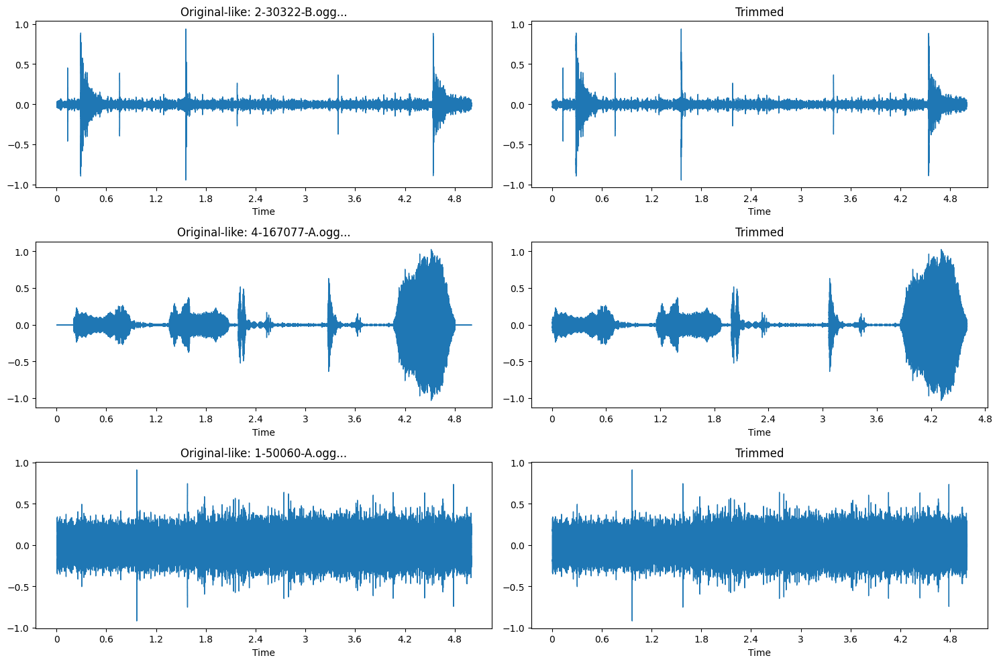

In [ ]:
# Pick 3 random files from the dataframe to visualize
sample_files = random.sample(df['full_path'].tolist(), 3)

plt.figure(figsize=(15, 10))

for i, path in enumerate(sample_files, 1):
    # Load trimmed file
    y_trimmed, sr = librosa.load(path, sr=None)

    # Get silence info from df
    row = df[df['full_path'] == path].iloc[0]
    silence_dur = row['silence_duration']
    silence_samples = int(silence_dur * sr)

    # Reconstruct approximate "original-like" waveform
    y_original_like = np.concatenate([
        np.zeros(silence_samples // 2),
        y_trimmed,
        np.zeros(silence_samples - silence_samples // 2)
    ])

    # Plot original-like waveform
    plt.subplot(len(sample_files), 2, 2*i-1)
    librosa.display.waveshow(y_original_like, sr=sr)
    plt.title(f"Original-like: {row['filename'][:40]}...")

    # Plot trimmed waveform
    plt.subplot(len(sample_files), 2, 2*i)
    librosa.display.waveshow(y_trimmed, sr=sr)
    plt.title("Trimmed")

plt.tight_layout()
plt.show()

In [ ]:
# Pick 1 random file from each class
samples = []
for cls in df['class'].unique():
    sample = df[df['class'] == cls].sample(1).iloc[0]
    samples.append(sample)

for i, row in enumerate(samples, 1):
    path = row['full_path']
    y_trimmed, sr = librosa.load(path, sr=None)

    # Reconstruct approximate original-like waveform
    silence_dur = row['silence_duration']
    silence_samples = int(silence_dur * sr)
    y_original_like = np.concatenate([
        np.zeros(silence_samples // 2),
        y_trimmed,
        np.zeros(silence_samples - silence_samples // 2)
    ])

    print(f"\nClass: {row['class']} | File: {row['filename'][:40]}...")

    print("Original-like (with silence):")
    display(Audio(y_original_like, rate=sr))

    print("Trimmed (silence removed):")
    display(Audio(y_trimmed, rate=sr))


Class: Rain | File: 2-87781-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Frog | File: 5-156026-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Baby cry | File: 5-198411-B.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Fire crackling | File: 2-65747-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Chainsaw | File: 4-165823-B.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Clock tick | File: 1-62850-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Dog | File: 3-170015-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Pig | File: 2-166644-C.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Helicopter | File: 2-188822-C.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Sea waves | File: 5-208810-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Person sneeze | File: 2-82538-A.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Rooster | File: 5-234879-B.ogg...
Original-like (with silence):


Trimmed (silence removed):



Class: Cow | File: 1-202111-A.ogg...
Original-like (with silence):


Trimmed (silence removed):


count    520.000000
mean       5.624962
std        4.730067
min        0.436392
25%        2.427531
50%        4.250944
75%        7.148543
max       31.015226
Name: snr, dtype: float64


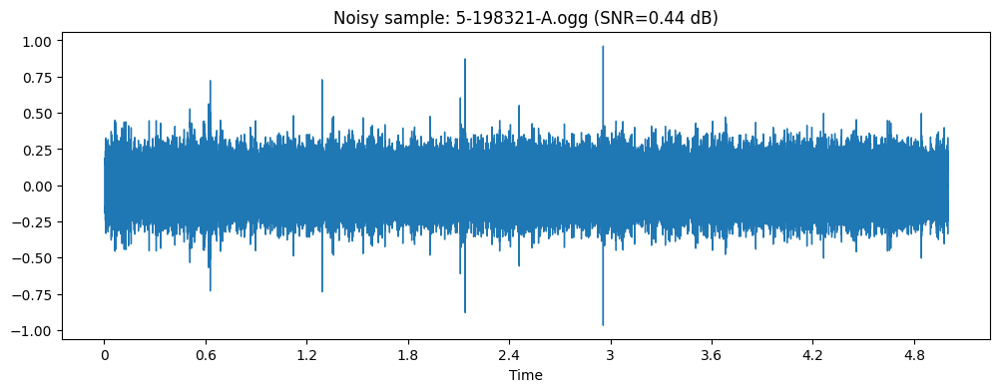

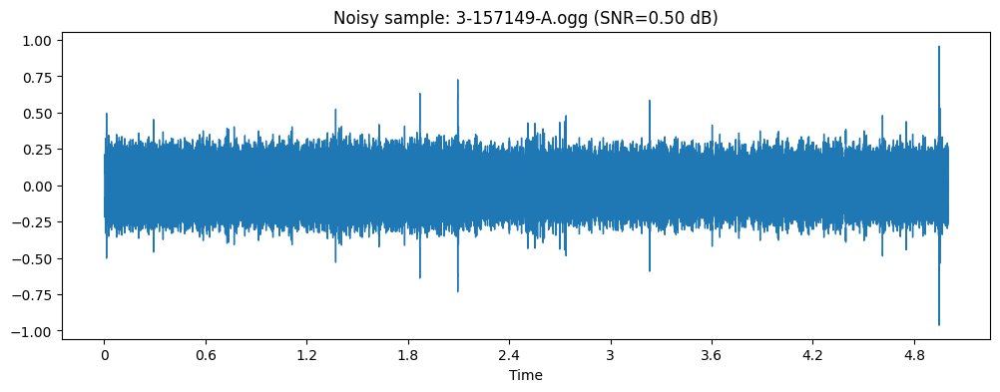

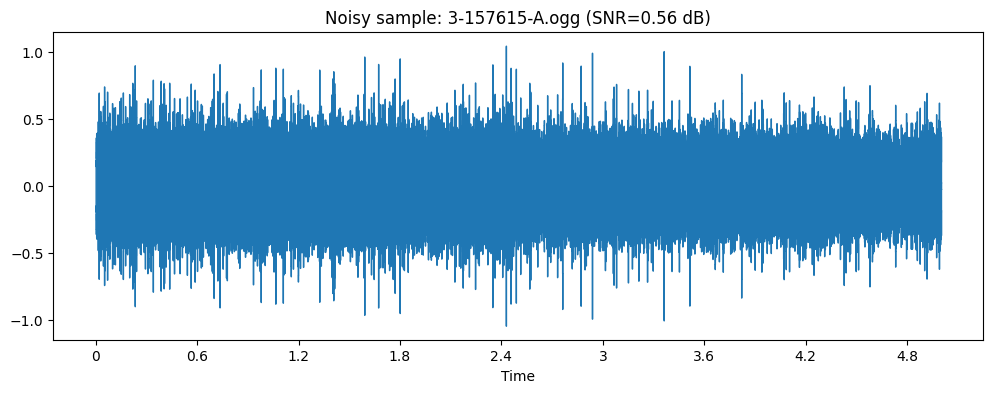

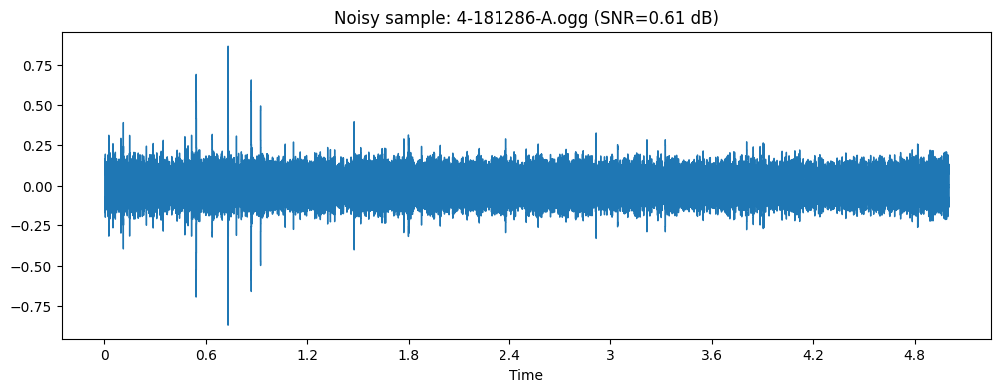

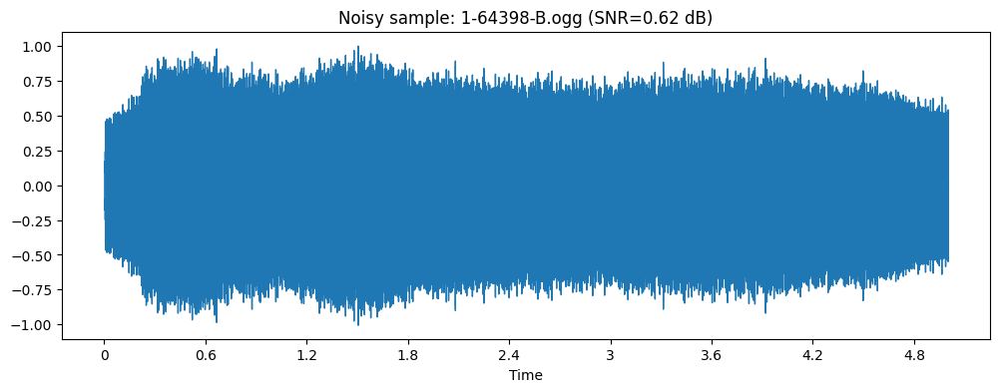

In [ ]:
# Quantify noise with SNR (Signal-to-Noise Ratio)
def estimate_snr(y):
    # Split into signal (louder parts) and noise (quieter parts)
    rms = librosa.feature.rms(y=y)[0]
    signal = rms[rms > np.median(rms)].mean()   # louder frames
    noise = rms[rms <= np.median(rms)].mean()   # quieter frames

    if noise == 0:
        return np.inf  # perfect clean signal
    return 10 * np.log10(signal / noise)

df['snr'] = df['full_path'].apply(lambda path: estimate_snr(librosa.load(path, sr=None)[0]))
print(df['snr'].describe())

# Listen & visualize some samples
noisiest = df.nsmallest(5, 'snr')

for row in noisiest.to_dict(orient="records"):
    y, sr = librosa.load(row["full_path"], sr=None)
    plt.figure(figsize=(12,4))
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Noisy sample: {row['filename']} (SNR={row['snr']:.2f} dB)")
    plt.show()

In [ ]:
# Pick 150 random files across all classes
random_files = random.sample(df['full_path'].tolist(), 150) # random_files = df['full_path'].tolist() --> to apply for the whole dataset

denoised_count = 0

for path in random_files:
    try:
        y, sr = librosa.load(path, sr=None)

        # Estimate noise from first 0.25 sec
        noise_clip = y[:int(sr * 0.25)]

        # Apply denoising
        y_denoised = nr.reduce_noise(y=y, sr=sr, y_noise=noise_clip)

        # Overwrite file with denoised version
        sf.write(path, y_denoised, sr)
        denoised_count += 1

    except Exception as e:
        print(f"Error denoising {path}: {e}")

print(f"Denoised {denoised_count} random files out of {len(df)} total")

Denoised 150 random files out of 520 total


File: 2-30322-B.ogg


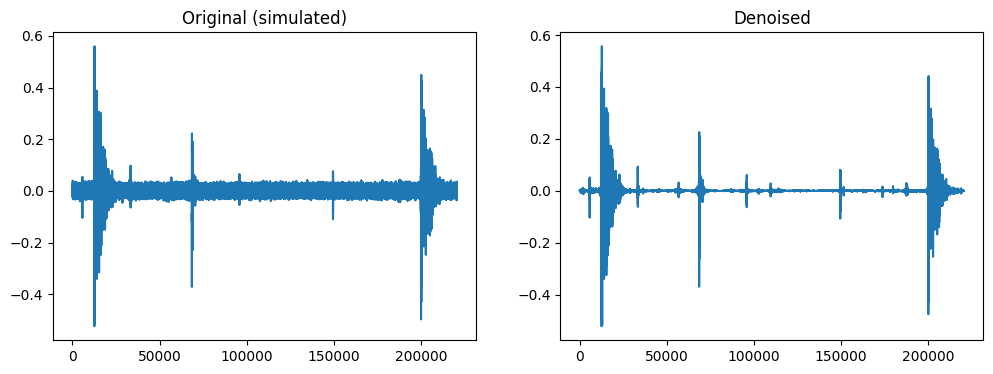

Original (simulated):


Denoised:


--------------------------------------------------
File: 2-118964-A.ogg


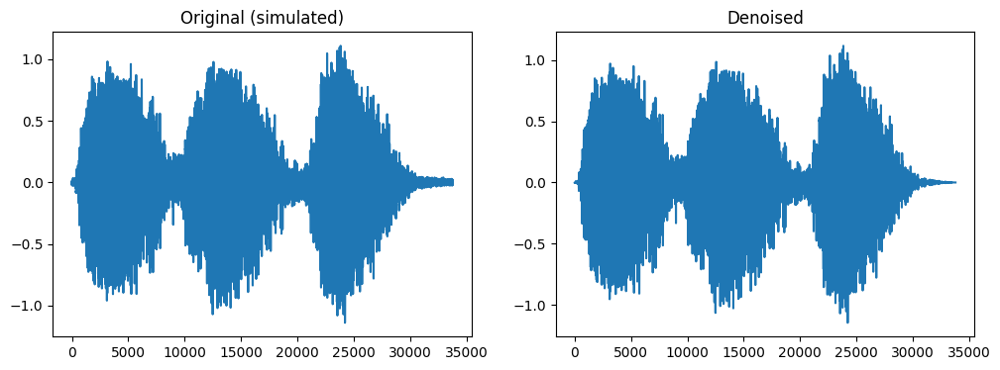

Original (simulated):


Denoised:


--------------------------------------------------
File: 3-170377-A.ogg


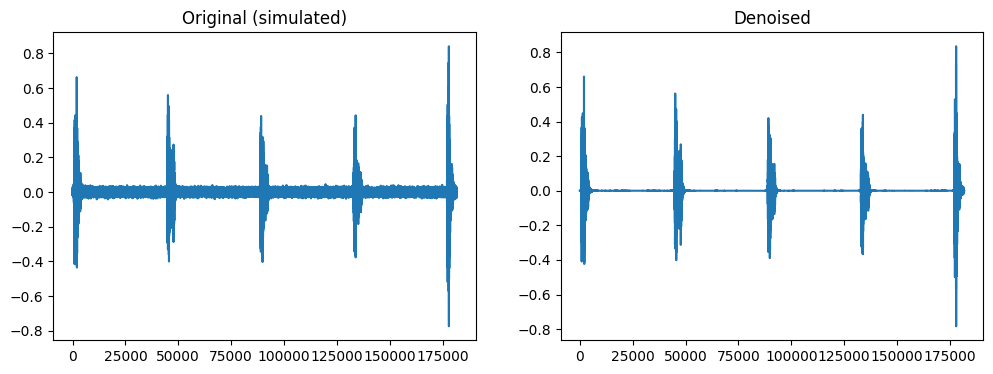

Original (simulated):


Denoised:


--------------------------------------------------
File: 5-200339-A.ogg


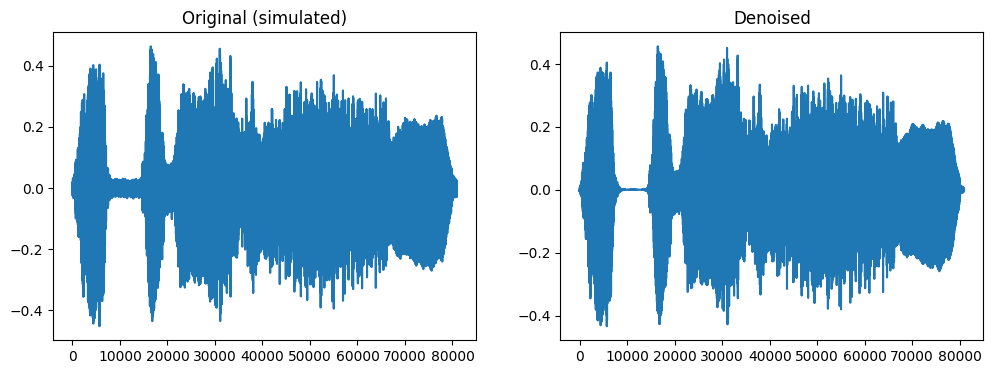

Original (simulated):


Denoised:


--------------------------------------------------
File: 3-170383-A.ogg


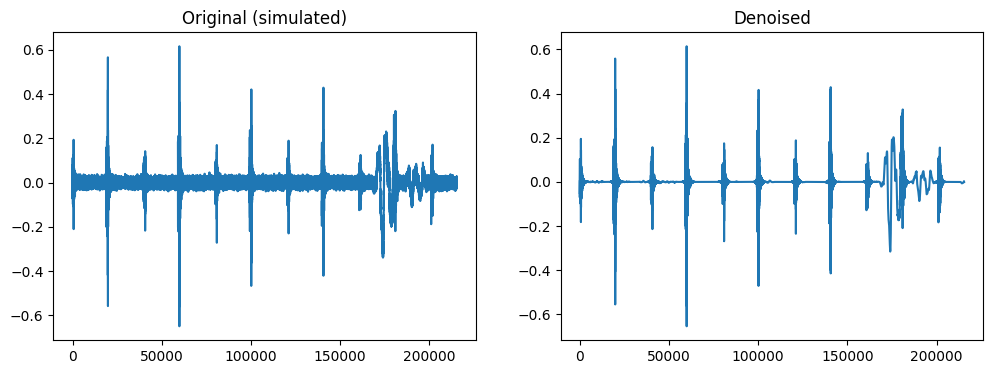

Original (simulated):


Denoised:


--------------------------------------------------


In [ ]:
# Pick 5 random denoised files
sample_denoised_files = random.sample(random_files, 5)

for path in sample_denoised_files:
    # Load denoised (from disk now)
    y_denoised, sr = librosa.load(path, sr=None)

    # Load original backup (if we had saved before overwriting)
    # Since we overwrote, simulate "original" by adding noise back
    # In real use, you'd backup before overwriting
    y_original = y_denoised + 0.01*np.random.randn(len(y_denoised))

    print(f"File: {path.split('/')[-1]}")

    # Plot waveform
    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1)
    plt.plot(y_original)
    plt.title("Original (simulated)")
    plt.subplot(1,2,2)
    plt.plot(y_denoised)
    plt.title("Denoised")
    plt.show()

    # Listen
    print("Original (simulated):")
    display(Audio(y_original, rate=sr))
    print("Denoised:")
    display(Audio(y_denoised, rate=sr))
    print("-"*50)

# **Data Preprocessing for Audio Dataset**

In [ ]:
target_sr = 16000
resampled_count = 0

for path in df['full_path']:
    try:
        y, sr = librosa.load(path, sr=None)

        if sr != target_sr:
            # Resample
            y_resampled = librosa.resample(y, orig_sr=sr, target_sr=target_sr)
            # Overwrite file with resampled audio
            sf.write(path, y_resampled, target_sr)
            resampled_count += 1

    except Exception as e:
        print(f"Error resampling {path}: {e}")

print(f"Resampled {resampled_count} files to {target_sr} Hz")

Resampled 520 files to 16000 Hz


In [ ]:
mono_count = 0

for path in df['full_path']:
    try:
        y, sr = librosa.load(path, sr=None, mono=True)  # force mono

        # Overwrite file as mono
        sf.write(path, y, sr)
        mono_count += 1

    except Exception as e:
        print(f"Error converting {path}: {e}")

print(f"Converted {mono_count} files to mono")

channels = []
for path in random.sample(df['full_path'].tolist(), 5):  # check 5 random files
    info = sf.info(path)
    channels.append((path.split("/")[-2:], info.channels))

channels

Converted 520 files to mono


[(['Dog', '2-114587-A.ogg'], 1),
 (['Frog', '5-187201-B.ogg'], 1),
 (['Person sneeze', '3-142601-A.ogg'], 1),
 (['Frog', '3-70962-C.ogg'], 1),
 (['Frog', '4-99644-C.ogg'], 1)]

In [ ]:
TARGET_DURATION = 5.0  # seconds
TARGET_SR = 16000
TARGET_LENGTH = int(TARGET_DURATION * TARGET_SR)

base_dir = "/content/my_data/Audio Dataset"
split_dir = "/content/my_data/Audio Dataset_split"
os.makedirs(split_dir, exist_ok=True)

class_counts = {}

# Automatically detect all classes (subfolders)
classes = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]

for cls in classes:
    class_folder = os.path.join(base_dir, cls)
    save_folder = os.path.join(split_dir, cls)
    os.makedirs(save_folder, exist_ok=True)

    files = [f for f in os.listdir(class_folder) if f.endswith(".ogg")]
    total_chunks = 0

    for file in tqdm(files, desc=f"Splitting {cls}"):
        path = os.path.join(class_folder, file)
        y, sr = librosa.load(path, sr=TARGET_SR)

        total_samples = len(y)
        num_chunks = (total_samples + TARGET_LENGTH - 1) // TARGET_LENGTH  # ceil division

        for i in range(num_chunks):
            start = i * TARGET_LENGTH
            end = start + TARGET_LENGTH
            chunk = y[start:end]

            # pad last chunk if shorter
            if len(chunk) < TARGET_LENGTH:
                chunk = np.pad(chunk, (0, TARGET_LENGTH - len(chunk)), mode='constant')

            chunk_filename = f"{os.path.splitext(file)[0]}_chunk{i}.ogg"
            sf.write(os.path.join(save_folder, chunk_filename), chunk, sr)
            total_chunks += 1

    class_counts[cls] = total_chunks

print("Splitting done!")
print("Total chunks per class:")
for cls, count in class_counts.items():
    print(f"{cls}: {count}")

Splitting Cow: 100%|██████████| 40/40 [00:01<00:00, 26.75it/s]

Splitting done!
Total chunks per class:
Rain: 74
Frog: 50
Baby cry: 42
Fire crackling: 60
Chainsaw: 64
Clock tick: 46
Dog: 40
Pig: 45
Helicopter: 75
Sea waves: 71
Person sneeze: 40
Rooster: 40
Cow: 50


In [ ]:
balanced_dir = "/content/my_data/AudioDataset_balanced"
os.makedirs(balanced_dir, exist_ok=True)

TARGET_FILES_PER_CLASS = 75

for cls in class_counts.keys():
    class_folder = os.path.join(split_dir, cls)
    save_folder = os.path.join(balanced_dir, cls)
    os.makedirs(save_folder, exist_ok=True)

    files = [f for f in os.listdir(class_folder) if f.endswith(".ogg")]
    random.shuffle(files)

    if len(files) > TARGET_FILES_PER_CLASS:
        # Undersample
        selected_files = files[:TARGET_FILES_PER_CLASS]
    else:
        # Oversample (duplicate with renaming)
        selected_files = files.copy()
        while len(selected_files) < TARGET_FILES_PER_CLASS:
            extra = random.choice(files)
            new_name = f"aug_{len(selected_files)}_{extra}"
            shutil.copy(os.path.join(class_folder, extra),
                        os.path.join(save_folder, new_name))
            selected_files.append(new_name)
        # Copy originals after augmentation loop
        for f in files:
            shutil.copy(os.path.join(class_folder, f),
                        os.path.join(save_folder, f))
        continue

    # Copy selected files
    for f in selected_files:
        shutil.copy(os.path.join(class_folder, f),
                    os.path.join(save_folder, f))

print("Balancing done!")

# Quick check
for cls in os.listdir(balanced_dir):
    n_files = len([f for f in os.listdir(os.path.join(balanced_dir, cls)) if f.endswith(".ogg")])
    print(f"{cls}: {n_files}")

Balancing done!
Rain: 75
Frog: 75
Baby cry: 75
Fire crackling: 75
Chainsaw: 75
Clock tick: 75
Dog: 75
Pig: 75
Helicopter: 75
Sea waves: 75
Person sneeze: 75
Rooster: 75
Cow: 75


In [ ]:
audio_extensions = {".wav", ".mp3", ".ogg"}
paths = [(path.parts[-2], path.name, str(path)) for path in Path(balanced_dir).rglob('*.*') if path.suffix.lower() in audio_extensions]

df = pd.DataFrame(paths, columns = ['class', 'image', 'full_path'])
df = df.sort_values('class', ascending = True)
df.reset_index(drop = True, inplace = True)
df

,class,image,full_path
0,Baby cry,5-198411-G_chunk0.ogg,/content/my_data/AudioDataset_balanced/Baby cr...
1,Baby cry,1-60997-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Baby cr...
2,Baby cry,5-151085-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Baby cr...
3,Baby cry,4-59579-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Baby cr...
4,Baby cry,aug_49_3-151081-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Baby cr...
...,...,...,...
970,Sea waves,5-200461-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Sea wav...
971,Sea waves,4-167063-A_chunk0.ogg,/content/my_data/AudioDataset_balanced/Sea wav...
972,Sea waves,aug_74_3-144827-B_chunk0.ogg,/content/my_data/AudioDataset_balanced/Sea wav...
973,Sea waves,1-39901-A_chunk1.ogg,/content/my_data/AudioDataset_balanced/Sea wav...


In [ ]:
TARGET_DURATION = 5.0  # seconds
TARGET_SR = 16000
TARGET_LENGTH = int(TARGET_DURATION * TARGET_SR)

balanced_dir = "/content/my_data/AudioDataset_balanced"

all_chunks_ok = True

# Automatically detect all classes in balanced_dir
classes = [d for d in os.listdir(balanced_dir) if os.path.isdir(os.path.join(balanced_dir, d))]

for cls in classes:
    class_folder = os.path.join(balanced_dir, cls)
    files = [f for f in os.listdir(class_folder) if f.endswith(".ogg")]

    for f in files:
        path = os.path.join(class_folder, f)
        y, sr = librosa.load(path, sr=TARGET_SR)
        if len(y) != TARGET_LENGTH:
            print(f"{cls}/{f} length: {len(y)/sr:.2f}s (should be 5s)")
            all_chunks_ok = False

if all_chunks_ok:
    print("All chunks are exactly 5 seconds long!")

All chunks are exactly 5 seconds long!


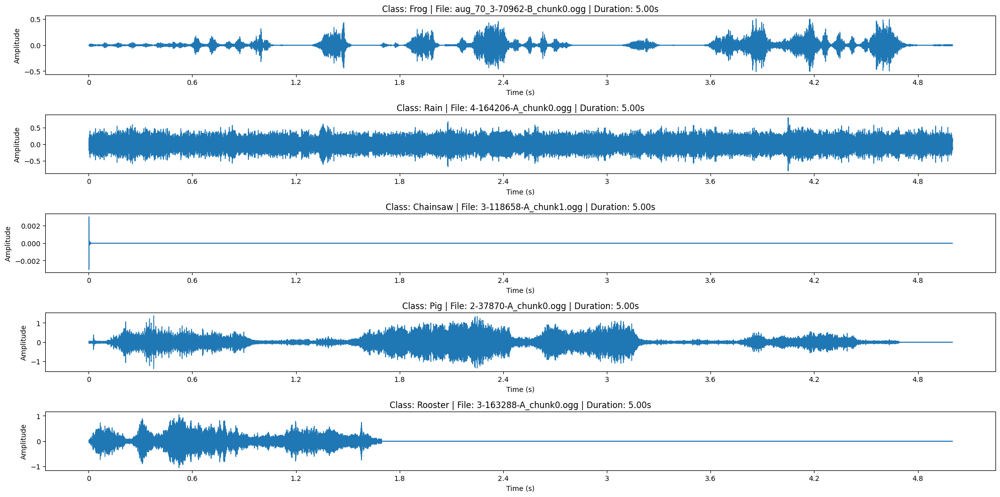

In [ ]:
# Parameters
TARGET_SR = 16000
TARGET_DURATION = 5.0
balanced_dir = "/content/my_data/AudioDataset_balanced"  # adjust to your balanced folder

# Collect all files
all_files = []
classes = [d for d in os.listdir(balanced_dir) if os.path.isdir(os.path.join(balanced_dir, d))]

for cls in classes:
    class_folder = os.path.join(balanced_dir, cls)
    files = [os.path.join(class_folder, f) for f in os.listdir(class_folder) if f.endswith(".ogg")]
    all_files.extend([(cls, f) for f in files])

# Sample 5 random files
sample_files = random.sample(all_files, min(5, len(all_files)))

plt.figure(figsize=(20, 10))

for i, (cls, path) in enumerate(sample_files, 1):
    y, sr = librosa.load(path, sr=TARGET_SR)
    plt.subplot(5, 1, i)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Class: {cls} | File: {os.path.basename(path)} | Duration: {len(y)/sr:.2f}s")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

plt.tight_layout()
plt.show()

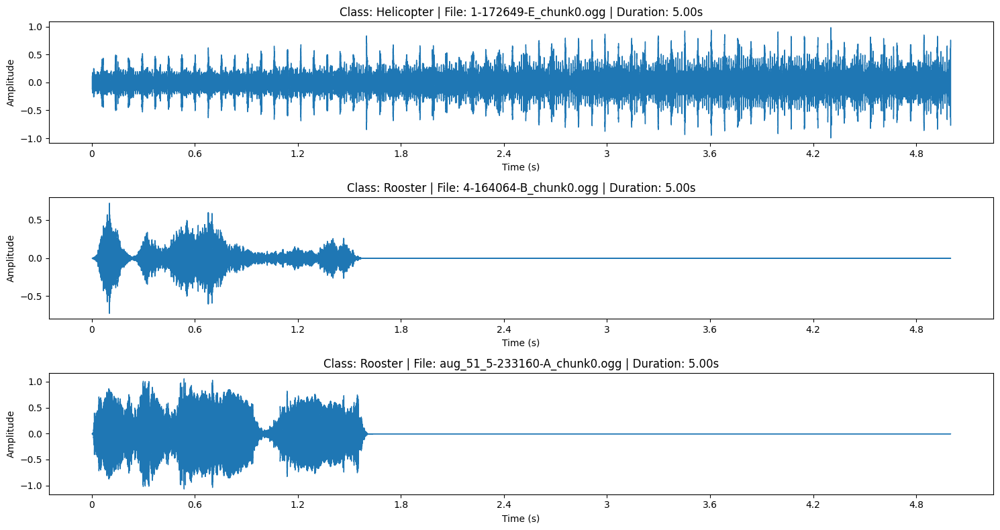

In [ ]:
# Parameters
TARGET_SR = 16000
balanced_dir = "/content/my_data/AudioDataset_balanced"  # adjust if needed

# Collect all files
all_files = []
classes = [d for d in os.listdir(balanced_dir) if os.path.isdir(os.path.join(balanced_dir, d))]

for cls in classes:
    class_folder = os.path.join(balanced_dir, cls)
    files = [os.path.join(class_folder, f) for f in os.listdir(class_folder) if f.endswith(".ogg")]
    all_files.extend([(cls, f) for f in files])

# Sample 3 random files (to keep notebook clean)
sample_files = random.sample(all_files, min(3, len(all_files)))

plt.figure(figsize=(15, 8))

for i, (cls, path) in enumerate(sample_files, 1):
    y, sr = librosa.load(path, sr=TARGET_SR)

    # Plot waveform
    plt.subplot(3, 1, i)
    librosa.display.waveshow(y, sr=sr)
    plt.title(f"Class: {cls} | File: {os.path.basename(path)} | Duration: {len(y)/sr:.2f}s")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # Audio player
    display(Audio(y, rate=sr))

plt.tight_layout()
plt.show()

In [ ]:
# Define augmentation pipeline
augment = Compose([
    Shift(min_shift=-0.3, max_shift=0.3, p=0.5),                        # Time shift
    PitchShift(min_semitones=-2, max_semitones=2, p=0.5),               # Pitch shift
    TimeStretch(min_rate=0.8, max_rate=1.25, p=0.5),                    # Speed up / slow down
    AddGaussianNoise(min_amplitude=0.001, max_amplitude=0.015, p=0.5)   # Background noise
])

# Apply augmentations to balance dataset or just expand it
AUG_PER_CLASS = 50  # how many augmented samples per class

for cls in df['class'].unique():
    class_df = df[df['class'] == cls]
    files = class_df['full_path'].tolist()

    # Randomly sample files to augment
    to_augment = random.sample(files, min(len(files), AUG_PER_CLASS))

    for path in tqdm(to_augment, desc=f"Augmenting {cls}"):
        try:
            y, sr = librosa.load(path, sr=None)
            y_aug = augment(samples=y, sample_rate=sr)

            # Unique filename per augmented file
            new_filename = os.path.splitext(os.path.basename(path))[0] + f"__aug_{uuid.uuid4().hex[:6]}.ogg"

            # Save into the original split folder for this class
            split_class_dir = f"/content/my_data/AudioDataset_balanced/{cls}"
            os.makedirs(split_class_dir, exist_ok=True)
            new_path = os.path.join(split_class_dir, new_filename)

            sf.write(new_path, y_aug, sr)

            # Add to DataFrame
            df = pd.concat([df, pd.DataFrame({
                "class": [cls],
                "filename": [new_filename],
                "full_path": [new_path],
                "augmented": [True]
            })], ignore_index=True)

        except Exception as e:
            print(f"Error augmenting {path}: {e}")

print("\nAudio augmentations applied and saved to AudioDataset_balanced")

Augmenting Sea waves: 100%|██████████| 50/50 [00:05<00:00,  8.56it/s]


Audio augmentations applied and saved to AudioDataset_balanced


In [ ]:
split_dir = "/content/my_data/AudioDataset_balanced"

# Get all class folders automatically
classes = [d for d in os.listdir(split_dir) if os.path.isdir(os.path.join(split_dir, d))]

# Count total files per class
for cls in classes:
    folder = os.path.join(split_dir, cls)
    files = [f for f in os.listdir(folder) if f.endswith(".ogg")]
    print(f"{cls}: {len(files)} files")

# Count augmented files per class
for cls in classes:
    folder = os.path.join(split_dir, cls)
    files = [f for f in os.listdir(folder) if f.endswith(".ogg")]
    aug_files = [f for f in files if "_aug" in f]

    print(f"\nClass: {cls}")
    print(f" Total files: {len(files)}")
    print(f" Augmented files: {len(aug_files)}")
    print(" Sample augmented:", aug_files[:5])


Rain: 125 files
Frog: 125 files
Baby cry: 125 files
Fire crackling: 125 files
Chainsaw: 125 files
Clock tick: 125 files
Dog: 125 files
Pig: 125 files
Helicopter: 125 files
Sea waves: 125 files
Person sneeze: 125 files
Rooster: 125 files
Cow: 125 files

Class: Rain
 Total files: 125
 Augmented files: 50
 Sample augmented: ['3-140774-A_chunk0__aug_a9b632.ogg', '1-26222-A_chunk0__aug_a71e5c.ogg', '5-202898-A_chunk0__aug_7f0df6.ogg', '5-193339-A_chunk1__aug_3d2366.ogg', '4-180380-A_chunk0__aug_b59497.ogg']

Class: Frog
 Total files: 125
 Augmented files: 50
 Sample augmented: ['2-32515-B_chunk0__aug_23b556.ogg', '4-99644-B_chunk1__aug_4437d0.ogg', '3-71964-B_chunk0__aug_c97b48.ogg', '4-130584-A_chunk0__aug_4768bb.ogg', '1-18755-A_chunk0__aug_7b3699.ogg']

Class: Baby cry
 Total files: 125
 Augmented files: 50
 Sample augmented: ['4-185575-C_chunk0__aug_7ac22e.ogg', 'aug_50_1-211527-C_chunk0__aug_1c954b.ogg', '1-211527-A_chunk0__aug_23b994.ogg', '1-60997-A_chunk0__aug_6ddb22.ogg', '4-185575

# **Convert the Audio Dataset to Mel Spectrogram Images**

In [ ]:
# Parameters
SR = 16000
N_FFT = 1024
HOP_LENGTH = 512
N_MELS = 128

# Original dataset path
base_audio_dir = "/content/my_data/AudioDataset_balanced/"

# Folder to save spectrograms (will create subfolders per class)
spec_dir = "/content/spectrograms"
os.makedirs(spec_dir, exist_ok=True)

def save_mel_spectrogram(path, save_dir, cls):
    try:
        y, sr = librosa.load(path, sr=SR)
        S = librosa.feature.melspectrogram(
            y=y, sr=sr, n_fft=N_FFT, hop_length=HOP_LENGTH, n_mels=N_MELS
        )
        S_dB = librosa.power_to_db(S, ref=np.max)

        # Create class folder inside spectrograms directory
        cls_dir = os.path.join(save_dir, cls)
        os.makedirs(cls_dir, exist_ok=True)

        # Save as image
        plt.figure(figsize=(3, 3))
        librosa.display.specshow(S_dB, sr=sr, hop_length=HOP_LENGTH,
                                 x_axis=None, y_axis=None, cmap="magma")
        plt.axis("off")
        fname = os.path.splitext(os.path.basename(path))[0] + ".png"
        save_path = os.path.join(cls_dir, fname)
        plt.savefig(save_path, bbox_inches="tight", pad_inches=0)
        plt.close()
        return save_path
    except Exception as e:
        print(f"Error processing {path}: {e}")
        return None

# Collect all classes dynamically
classes = [d for d in os.listdir(base_audio_dir) if os.path.isdir(os.path.join(base_audio_dir, d))]

# Gather all files with class info
all_files = []
for cls in classes:
    folder = os.path.join(base_audio_dir, cls)
    files = glob.glob(f"{folder}/*.ogg")  # original + augmented
    for f in files:
        all_files.append((cls, os.path.basename(f), f))

df = pd.DataFrame(all_files, columns=['class', 'filename', 'full_path'])

# Generate spectrograms
spec_paths = []
for idx, row in tqdm(df.iterrows(), total=len(df), desc="Generating Mel-spectrograms"):
    save_path = save_mel_spectrogram(row['full_path'], spec_dir, row['class'])
    spec_paths.append(save_path)

# Add spectrogram paths to DataFrame
df['spec_path'] = spec_paths

print("All spectrograms generated with correct class folders")
print(df.head())

Generating Mel-spectrograms: 100%|██████████| 1625/1625 [03:50<00:00,  7.04it/s]

All spectrograms generated with correct class folders
  class                           filename  \
0  Rain               1-54958-A_chunk0.ogg   
1  Rain       aug_74_4-166661-A_chunk1.ogg   
2  Rain              5-195710-A_chunk1.ogg   
3  Rain  3-140774-A_chunk0__aug_a9b632.ogg   
4  Rain   1-26222-A_chunk0__aug_a71e5c.ogg   

                                           full_path  \
0  /content/my_data/AudioDataset_balanced/Rain/1-...   
1  /content/my_data/AudioDataset_balanced/Rain/au...   
2  /content/my_data/AudioDataset_balanced/Rain/5-...   
3  /content/my_data/AudioDataset_balanced/Rain/3-...   
4  /content/my_data/AudioDataset_balanced/Rain/1-...   

                                           spec_path  
0    /content/spectrograms/Rain/1-54958-A_chunk0.png  
1  /content/spectrograms/Rain/aug_74_4-166661-A_c...  
2   /content/spectrograms/Rain/5-195710-A_chunk1.png  
3  /content/spectrograms/Rain/3-140774-A_chunk0__...  
4  /content/spectrograms/Rain/1-26222-A_chunk0__a...  


In [ ]:
df['class'].value_counts()

,count
class,
Rain,125
Frog,125
Baby cry,125
Fire crackling,125
Chainsaw,125
Clock tick,125
Dog,125
Pig,125
Helicopter,125


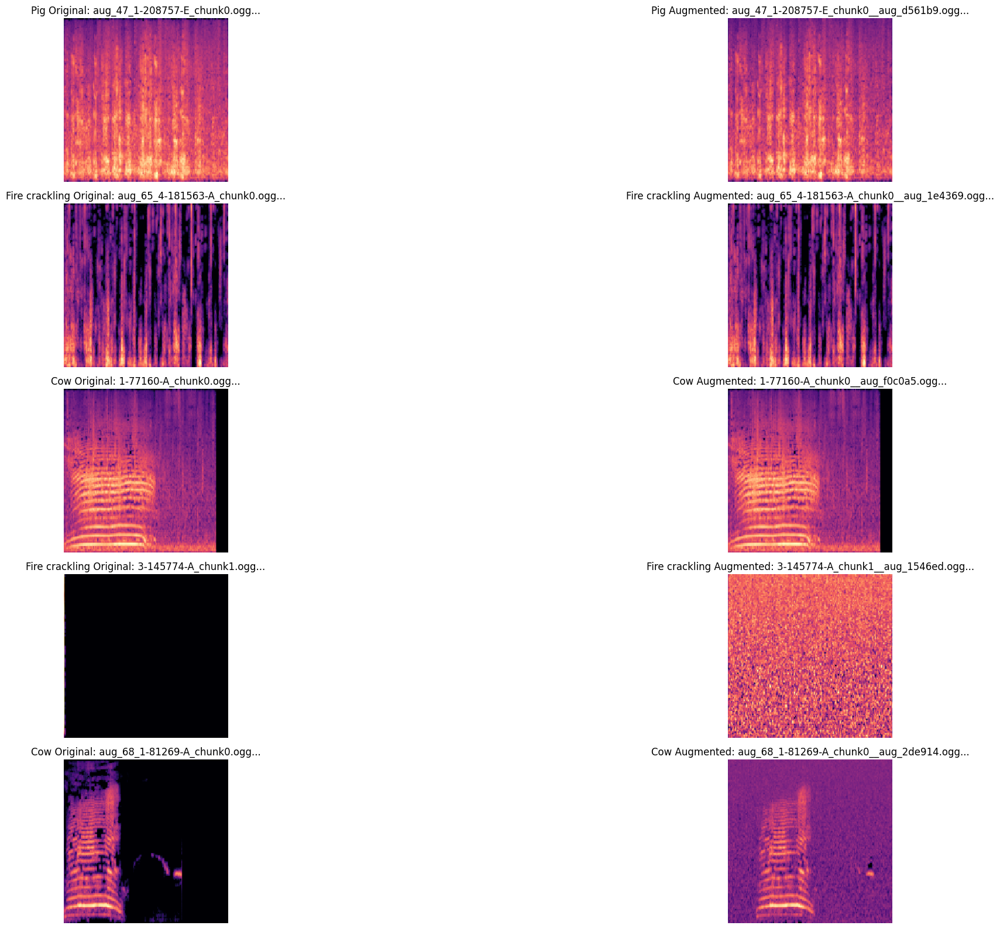

In [ ]:
# List of all augmented filenames
aug_files = df[df['filename'].str.contains("_aug")]

# Keep only originals that have at least one matching augmented file in the same class
original_with_aug = []
for idx, row in df.iterrows():
    if "_aug" not in row['filename']:
        cls = row['class']
        # Check if any augmented file in same class matches this original
        matches = aug_files[(aug_files['class'] == cls) &
                            (aug_files['filename'].str.startswith(os.path.splitext(row['filename'])[0]))]
        if len(matches) > 0:
            original_with_aug.append(row)

# Sample 5 originals safely
sample_originals = random.sample(original_with_aug, min(5, len(original_with_aug)))

plt.figure(figsize=(32, 16))

for i, orig_row in enumerate(sample_originals, 1):
    orig_fname = orig_row['filename']
    cls = orig_row['class']
    orig_path = orig_row['spec_path']  # use the DataFrame path

    # Get first matching augmented version in the same class
    aug_row = aug_files[(aug_files['class'] == cls) &
                        (aug_files['filename'].str.startswith(os.path.splitext(orig_fname)[0]))].iloc[0]
    aug_path = aug_row['spec_path']

    # Load images
    img_orig = mpimg.imread(orig_path)
    img_aug = mpimg.imread(aug_path)

    # Plot original
    plt.subplot(5, 2, 2*i-1)
    plt.imshow(img_orig)
    plt.title(f"{cls} Original: {orig_fname[:60]}...")
    plt.axis("off")

    # Plot augmented
    plt.subplot(5, 2, 2*i)
    plt.imshow(img_aug)
    plt.title(f"{cls} Augmented: {aug_row['filename'][:60]}...")
    plt.axis("off")

plt.tight_layout()
plt.show()

# **Convert Spectrogram Images Dataset to a DataFrame**

In [ ]:
image_extensions = {'.jpg', '.jpeg', '.png'}
paths = [(path.parts[-2], path.name, str(path)) for path in Path(spec_dir).rglob('*.*') if path.suffix.lower() in image_extensions]

df = pd.DataFrame(paths, columns = ['class', 'image', 'full_path'])
df = df.sort_values('class', ascending = True)
df.reset_index(drop = True, inplace = True)
df

,class,image,full_path
0,Baby cry,aug_70_2-80482-A_chunk0.png,/content/spectrograms/Baby cry/aug_70_2-80482-...
1,Baby cry,1-22694-B_chunk0.png,/content/spectrograms/Baby cry/1-22694-B_chunk...
2,Baby cry,1-22694-A_chunk0__aug_5ef2f7.png,/content/spectrograms/Baby cry/1-22694-A_chunk...
3,Baby cry,aug_63_5-198411-B_chunk0__aug_b2727f.png,/content/spectrograms/Baby cry/aug_63_5-198411...
4,Baby cry,2-50665-A_chunk0__aug_a3e212.png,/content/spectrograms/Baby cry/2-50665-A_chunk...
...,...,...,...
1620,Sea waves,2-137162-A_chunk1__aug_f9c10a.png,/content/spectrograms/Sea waves/2-137162-A_chu...
1621,Sea waves,2-125966-A_chunk1.png,/content/spectrograms/Sea waves/2-125966-A_chu...
1622,Sea waves,4-204618-A_chunk0.png,/content/spectrograms/Sea waves/4-204618-A_chu...
1623,Sea waves,1-39901-A_chunk0.png,/content/spectrograms/Sea waves/1-39901-A_chun...


# **EDA Process for Spectrogram Dataset**

In [ ]:
class_count = df['class'].value_counts()
for cls, count in class_count.items():
    print(f'Class: {cls}, Count: {count} images')

print(f"\nTotal dataset size is: {len(df)} images")
print(f"Number of classes: {df['class'].nunique()} classes")

Class: Baby cry, Count: 125 images
Class: Chainsaw, Count: 125 images
Class: Clock tick, Count: 125 images
Class: Cow, Count: 125 images
Class: Dog, Count: 125 images
Class: Fire crackling, Count: 125 images
Class: Frog, Count: 125 images
Class: Helicopter, Count: 125 images
Class: Person sneeze, Count: 125 images
Class: Pig, Count: 125 images
Class: Rain, Count: 125 images
Class: Rooster, Count: 125 images
Class: Sea waves, Count: 125 images

Total dataset size is: 1625 images
Number of classes: 13 classes


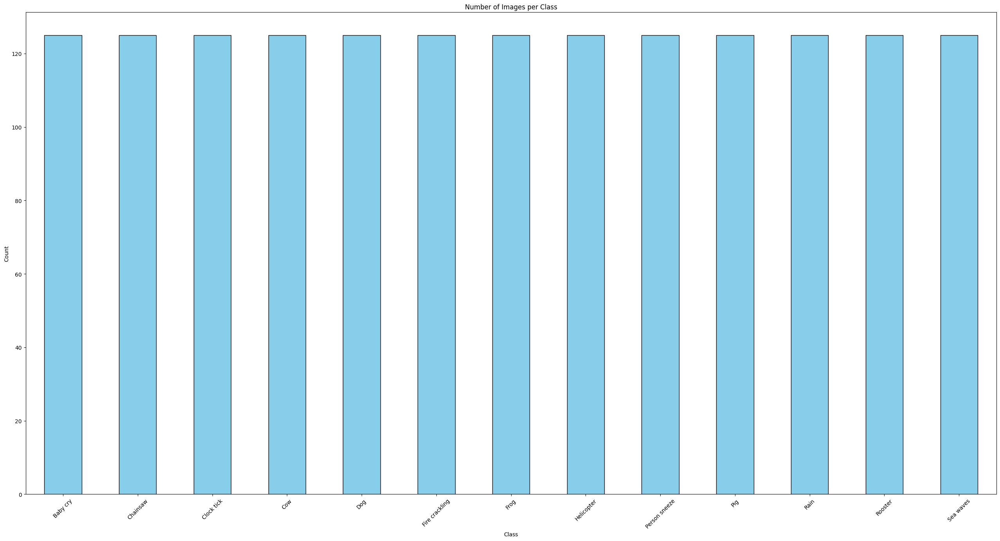

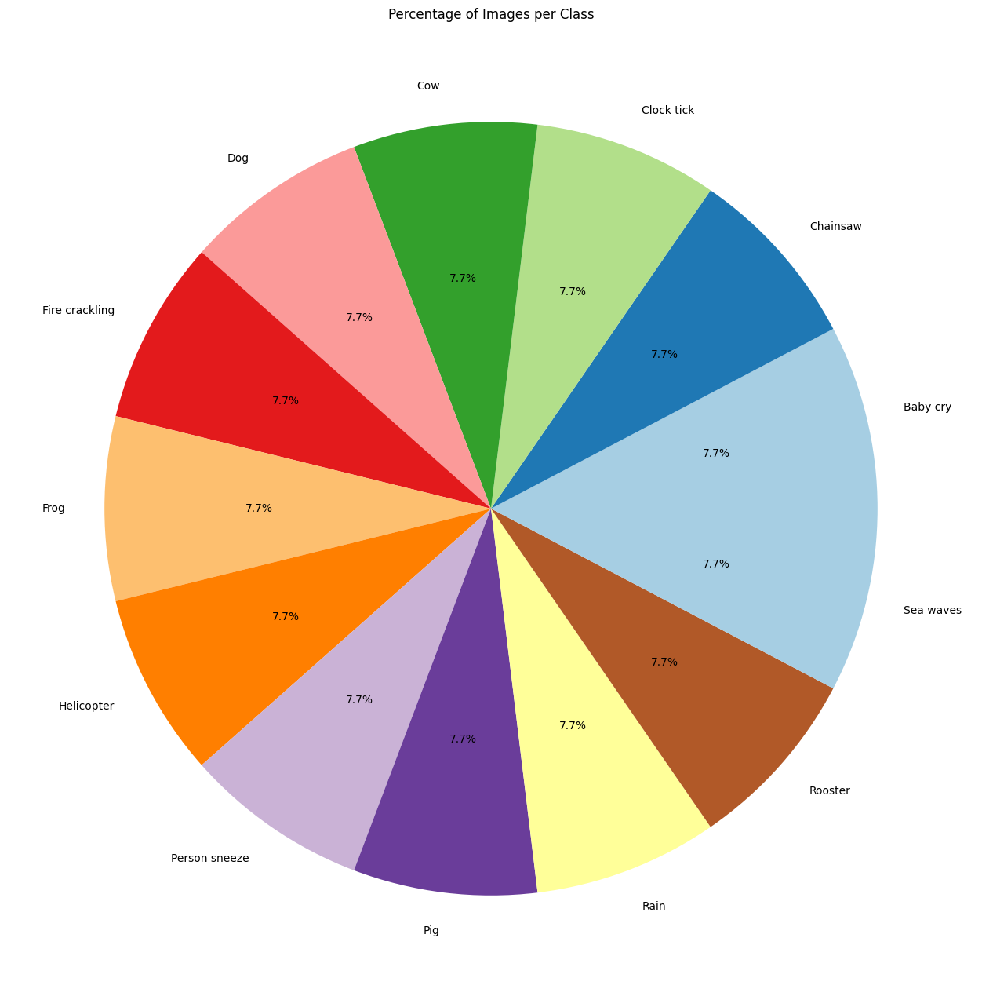

In [ ]:
plt.figure(figsize = (32, 16))
class_count.plot(kind = 'bar', color = 'skyblue', edgecolor = 'black')
plt.title('Number of Images per Class')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation = 45)
plt.show()

plt.figure(figsize = (32, 16))
class_count.plot(kind = 'pie', autopct = '%1.1f%%', colors = plt.cm.Paired.colors)
plt.title('Percentage of Images per Class')
plt.ylabel('')
plt.show()

                Count  Percentage %
class                              
Baby cry          125          7.69
Chainsaw          125          7.69
Clock tick        125          7.69
Cow               125          7.69
Dog               125          7.69
Fire crackling    125          7.69
Frog              125          7.69
Helicopter        125          7.69
Person sneeze     125          7.69
Pig               125          7.69
Rain              125          7.69
Rooster           125          7.69
Sea waves         125          7.69


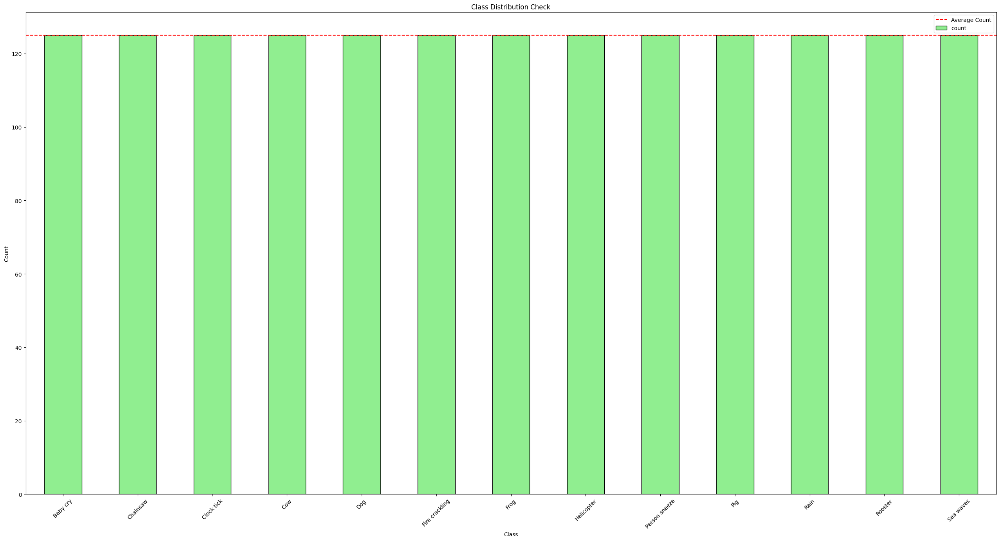

In [ ]:
percentages = (class_count / len(df)) * 100
imbalance_df = pd.DataFrame({'Count': class_count, 'Percentage %': percentages.round(2)})
print(imbalance_df)

plt.figure(figsize = (32, 16))
class_count.plot(kind = 'bar', color = 'lightgreen', edgecolor = 'black')
plt.title('Class Distribution Check')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation = 45)
plt.axhline(y = class_count.mean(), color = 'red', linestyle = '--', label = 'Average Count')
plt.legend()
plt.show()

In [ ]:
image_info = []

for file_path in df['full_path']:
    try:
        with Image.open(file_path) as img:
            width, height = img.size
            mode = img.mode  # 'L', 'RGB', 'RGBA', etc.

            # Determine channels from mode
            if mode == 'RGB':
                channels = 3
            elif mode == 'L':
                channels = 1
            elif mode == 'RGBA':
                channels = 4
            else:
                channels = 'Unknown'

            image_info.append((width, height, channels))

    except Exception as e:
        print(f"Error reading {file_path}: {e}")
        image_info.append((None, None, 'Error'))

# Create DataFrame
sizes_df = pd.DataFrame(image_info, columns=['Width', 'Height', 'Channels'])

# Show unique (W, H, Channels) combos and how many images each
summary = sizes_df.value_counts().reset_index(name='Count')
print("\n Unique (Width, Height, Channels) combinations:")
print(summary)

# Optional: show a sample
# print("\n Sample from dataset:")
# print(sizes_df.sample(5))


 Unique (Width, Height, Channels) combinations:
   Width  Height  Channels  Count
0    232     231         4   1625


Image: 1-19898-A_chunk0__aug_c20977.png | Class: Chainsaw | Size: 232x231 | Brightness: 175.1 | Contrast: 84.5
Image: 2-117795-A_chunk0__aug_12bc2d.png | Class: Cow | Size: 232x231 | Brightness: 131.5 | Contrast: 42.3
Image: 2-32515-B_chunk1.png | Class: Frog | Size: 232x231 | Brightness: 1.6 | Contrast: 17.4
Image: 1-208757-D_chunk0.png | Class: Pig | Size: 232x231 | Brightness: 207.6 | Contrast: 42.5
Image: aug_69_2-28314-B_chunk0__aug_1a402d.png | Class: Fire crackling | Size: 232x231 | Brightness: 153.6 | Contrast: 56.0
Image: 1-260640-C_chunk1.png | Class: Pig | Size: 232x231 | Brightness: 1.9 | Contrast: 19.2
Image: 2-102852-A_chunk0.png | Class: Sea waves | Size: 232x231 | Brightness: 244.1 | Contrast: 19.0
Image: 4-99644-D_chunk0.png | Class: Frog | Size: 232x231 | Brightness: 38.7 | Contrast: 76.3
Image: 5-177957-E_chunk1__aug_59701d.png | Class: Helicopter | Size: 232x231 | Brightness: 234.7 | Contrast: 28.2
Image: aug_46_2-88724-A_chunk0.png | Class: Clock tick | Size: 232x2

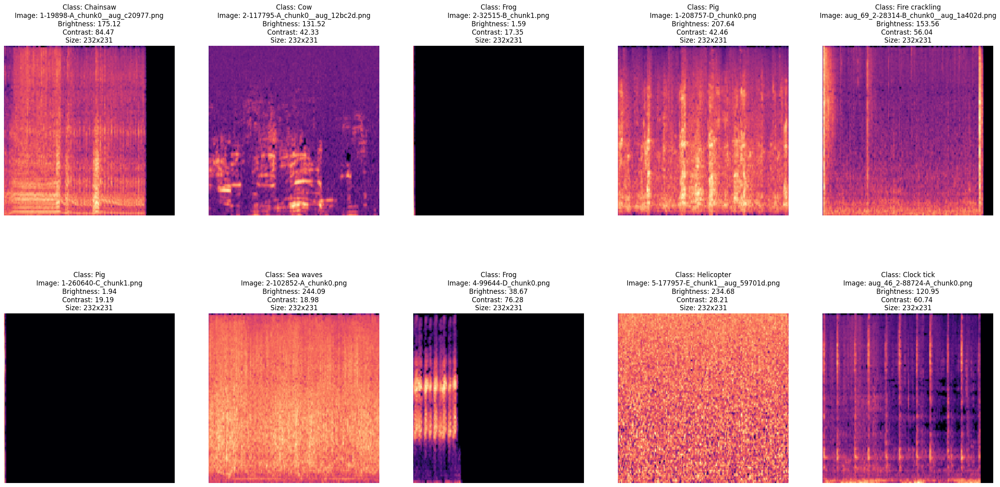

In [ ]:
sample_df = df.sample(n = 10, random_state = 42)

plt.figure(figsize=(32, 16))

for i, (cls, img_name, full_path) in enumerate(sample_df.values):
    with Image.open(full_path) as img:
      stat = ImageStat.Stat(img.convert("RGB")) #Convert images to RGB images
      brightness = stat.mean[0]
      contrast = stat.stddev[0]

      width, height = img.size
      # Print size to console
      print(f"Image: {img_name} | Class: {cls} | Size: {width}x{height} | Brightness: {brightness:.1f} | Contrast: {contrast:.1f}")

      plt.subplot(2, 5, i + 1)
      plt.imshow(img)
      plt.axis('off')
      plt.title(f"Class: {cls}\nImage: {img_name}\nBrightness: {brightness:.2f}\nContrast: {contrast:.2f} \nSize: {width}x{height}")

plt.tight_layout
plt.show()

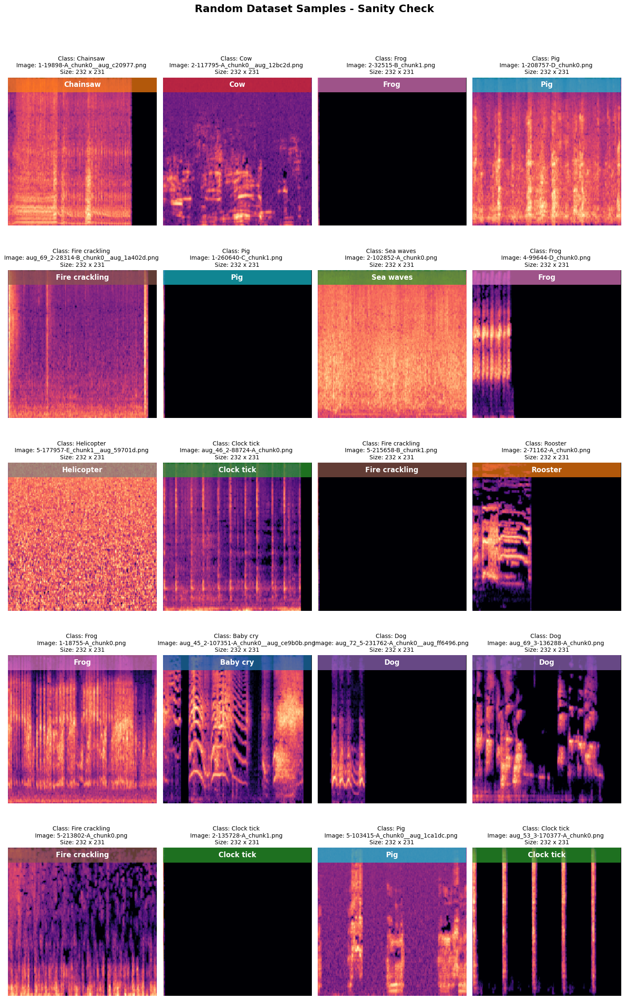

In [ ]:
# Sample 20 random images
num_samples = 20
sample_df = df.sample(num_samples, random_state=42)

# Get sorted class list and color map
classes = sorted(df['class'].unique())
colors = plt.cm.tab10.colors

# Grid setup
cols = 4
rows = num_samples // cols + int(num_samples % cols > 0)

# Figure setup
plt.figure(figsize=(15, 5 * rows))

for idx, (cls, img_name, full_path) in enumerate(sample_df.values):
    with Image.open(full_path) as img:
        ax = plt.subplot(rows, cols, idx + 1)
        ax.imshow(img)
        ax.axis('off')

        # Title with class info
        ax.set_title(
            f"Class: {cls} \nImage: {img_name} \nSize: {img.width} x {img.height}",
            fontsize=10
        )

        # ===== FIXED SIZE RECTANGLE IN AXES COORDINATES =====
        # Rectangle in axes coords: full width, small height at top
        label_height = 0.1  # 10% of image height
        label_width = 1.0   # full width of the image

        rect = patches.Rectangle(
        (0, 1 - label_height), label_width, label_height,
        transform=ax.transAxes,
        linewidth=0,
        edgecolor=None,
        facecolor=colors[classes.index(cls) % len(colors)],
        alpha=0.7
      )
        ax.add_patch(rect)

        # Add class name text centered horizontally
        ax.text(
        0.5, 1 - label_height / 2,
        cls,
        transform=ax.transAxes,
        fontsize=12,
        color="white",
        fontweight="bold",
        va="center",
        ha="center"
      )

# Figure title and layout
plt.suptitle("Random Dataset Samples - Sanity Check", fontsize=18, fontweight="bold")
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# **Data Cleaning Process for Spectrogram Images Dataset**

In [ ]:
#Check missing files
print("Missing values per column: ")
print(df.isnull().sum())

#Check duplicate files
duplicate_names = df.duplicated().sum()
print(f"\nNumber of duplicate files: {duplicate_names}")

duplicate_names = df[df.duplicated(subset = ['image'], keep = False)]
print(f"Duplicate file names: {len(duplicate_names)}")

#Check if two images or more are the same even if they are having different file names
def get_hash(file_path):
    with open(file_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

df['file_hash'] = df['full_path'].apply(get_hash)
duplicate_hashes = df[df.duplicated(subset = ['file_hash'], keep = False)]
print(f"Duplicate image files: {len(duplicate_hashes)}")

#This code below just removing the duplicate files, which means will not be feeded to the model, but will be still in the actual directory
#Important note: duplicates are removed from the dataframe only, not from the actual directory.
#Drop duplicates based on file_hash, keeping the first one

# df_unique = df.drop_duplicates(subset='file_hash', keep='first')
# print(f"After removing duplicates, unique images: {len(df_unique)}")

#Check for images extentions
df['extenstion'] = df['image'].apply(lambda x: Path(x).suffix.lower())
print("File type counts: ")
#print(df['extenstion'].value_counts)
print(df['extenstion'].value_counts())

#Check for resolution relationships
df['Width'] = sizes_df['Width']
df['Height'] = sizes_df['Height']
#print(df.groupby(['Width', 'Height']).size())
print(df.groupby('class')[['Width', 'Height']].agg(['min', 'max', 'mean']))

#Check for class balance (relationship between label and count)
class_summary = df['class'].value_counts(normalize = False).to_frame('Count')
#class_summary['Percentage'] = class_summary['Count'] / class_summary['Count'].sum() * 100
#class_summary
class_summary['Percentage %'] = round((class_summary['Count'] / len(df)) * 100, 2)
print(class_summary)

Missing values per column: 
class        0
image        0
full_path    0
dtype: int64

Number of duplicate files: 0
Duplicate file names: 0
Duplicate image files: 501
File type counts: 
extenstion
.png    1625
Name: count, dtype: int64
               Width             Height            
                 min  max   mean    min  max   mean
class                                              
Baby cry         232  232  232.0    231  231  231.0
Chainsaw         232  232  232.0    231  231  231.0
Clock tick       232  232  232.0    231  231  231.0
Cow              232  232  232.0    231  231  231.0
Dog              232  232  232.0    231  231  231.0
Fire crackling   232  232  232.0    231  231  231.0
Frog             232  232  232.0    231  231  231.0
Helicopter       232  232  232.0    231  231  231.0
Person sneeze    232  232  232.0    231  231  231.0
Pig              232  232  232.0    231  231  231.0
Rain             232  232  232.0    231  231  231.0
Rooster          232  232  232.0    

In [ ]:
corrupted_files = []

for file_path in df['full_path']:
    try:
        with Image.open(file_path) as img:
            img.verify()
    except (UnidentifiedImageError, OSError):
        corrupted_files.append(file_path)

print(f"Found {len(corrupted_files)} corrupted images.")
    #except (IOError, SyntaxError) as e:
        #corrupted_files.append(file_path)

#print(f"Number of corrupted files: {len(corrupted_files)}")

if corrupted_files:
  df = df[~df['full_path'].isin(corrupted_files)].reset_index(drop = True)
  print("Corrupted files removed.")

#Outliers detection
#Resolution-based outlier detection
#width_mean = width_std = sizes_df['Width'].mean(), sizes_df['Width'].std()
#height_mean = height_std = sizes_df['Height'].mean(), sizes_df['Height'].std()

width_mean = sizes_df['Width'].mean()
width_std = sizes_df['Width'].std()
height_mean = sizes_df['Height'].mean()
height_std = sizes_df['Height'].std()

outliers = df[(df['Width'] > width_mean + 3 * width_std) | (df['Width'] < width_mean - 3 * width_std) | (df['Height'] > height_mean + 3 * height_std) | (df['Height'] < height_mean - 3 * height_std)]
#print(f"Number of outliers: {len(outliers)}")
print(f"Found {len(outliers)} resolution outliers.")

df["image"] = df["full_path"].apply(lambda p: Image.open(p).convert('RGB')) #Convert it to RGB for flexibility

too_dark = []
too_bright = []
blank_or_gray = []

# Thresholds
dark_threshold = 30    # Below this is too dark
bright_threshold = 225 # Above this is too bright
low_contrast_threshold = 5  # Low contrast ~ blank/gray

for idx, img in enumerate(df["image"]):
    gray = img.convert('L')
    stat = ImageStat.Stat(gray)
    brightness = stat.mean[0]
    contrast = stat.stddev[0]

    if brightness < dark_threshold:
        too_dark.append(idx)
    elif brightness > bright_threshold:
        too_bright.append(idx)
    elif contrast < low_contrast_threshold:
        blank_or_gray.append(idx)

print(f"Too dark images: {len(too_dark)}")
print(f"Too bright images: {len(too_bright)}")
print(f"Blank/gray images: {len(blank_or_gray)}")

# df = df.drop(index=too_bright + blank_or_gray).reset_index(drop=True) --> DROPS too_bright + blank_or_gray TOGETHER!

# for idx, row in tqdm(df.iterrows(), total=len(df), desc="Enhancing images"):
#     img = row["image"]
#     if row["full_path"] in df.loc[too_dark, "full_path"].values:
#         img = ImageEnhance.Brightness(img).enhance(1.5)
#         img = ImageEnhance.Contrast(img).enhance(1.5)
#     df.at[idx, "image"] = img  # Overwrite image directly in df

# print(f"Enhanced images in memory: {len(df)}")

# still_dark = []
# for idx, img in enumerate(df["image"]):
#     gray = img.convert('L')
#     stat = ImageStat.Stat(gray)
#     brightness = stat.mean[0]
#     if brightness < dark_threshold:
#         still_dark.append(df.loc[idx, 'full_path'])

# print(f"Still too dark after enhancement: {len(still_dark)} images")

Found 0 corrupted images.
Found 0 resolution outliers.
Too dark images: 531
Too bright images: 0
Blank/gray images: 0


In [ ]:
# Point to the extracted dataset, not the zip file location
spec_dir = "/content/spectrograms"

# 1. Check mislabeled images
mismatches = []
for i, row in df.iterrows():
    folder_name = os.path.basename(os.path.dirname(row["full_path"]))
    if row["class"] != folder_name:
        mismatches.append((row["full_path"], row["class"], folder_name))

print(f"Found {len(mismatches)} mislabeled images (class vs folder mismatch).")

# 2. Compare classes vs folders
classes_in_df = set(df["class"].unique())
folders_in_fs = {f for f in os.listdir(spec_dir) if os.path.isdir(os.path.join(spec_dir, f))}

print("Classes in DF but not in folders:", classes_in_df - folders_in_fs)
print("Folders in FS but not in DF:", folders_in_fs - classes_in_df)

Found 0 mislabeled images (class vs folder mismatch).
Classes in DF but not in folders: set()
Folders in FS but not in DF: set()


In [ ]:
def check_file_naming_issues(df):
    issues = {"invalid_chars": [], "spaces": [], "long_paths": [], "case_conflicts": [], "duplicate_names_across_classes": []}

    seen_names = {}

    for _, row in df.iterrows():
        fpath = row["full_path"]              # full path
        fname = os.path.basename(fpath)       # just filename
        cls = row["class"]

        # 1. Invalid characters
        if re.search(r'[<>:"/\\|?*]', fname):  # Windows restricted chars
            issues["invalid_chars"].append(fpath)

        # 2. Spaces
        if "  " in fname or fname.startswith(" ") or fname.endswith(" "):
            issues["spaces"].append(fpath)

        # 3. Long paths
        if len(fpath) > 255:
            issues["long_paths"].append(fpath)

        # 4. Case conflicts
        lower_name = fname.lower()
        if lower_name in seen_names and seen_names[lower_name] != cls:
            issues["case_conflicts"].append((fpath, seen_names[lower_name]))
        else:
            seen_names[lower_name] = cls

    # 5. Duplicate names across classes
    duplicates = df.groupby(df["full_path"].apply(os.path.basename))["class"].nunique()
    duplicates = duplicates[duplicates > 1].index.tolist()
    for dup in duplicates:
        dup_paths = df[df["full_path"].str.endswith(dup)]["full_path"].tolist()
        issues["duplicate_names_across_classes"].extend(dup_paths)

    return issues

# Run the check
naming_issues = check_file_naming_issues(df)

for issue_type, files in naming_issues.items():
    print(f"\n{issue_type.upper()} ({len(files)})")
    for f in files[:10]:  # preview first 10
        print(f)


INVALID_CHARS (0)

SPACES (0)

LONG_PATHS (0)

CASE_CONFLICTS (0)

DUPLICATE_NAMES_ACROSS_CLASSES (0)


# **Data Preprocessing for Spectrogram Images Dataset**

In [ ]:
def preprocess_image(path, target_size=(231, 232)):
    # Load image, resize, convert to RGBA, and normalize to [0,1]
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=4, expand_animations=False)
    img = tf.image.resize(img, target_size)
    img = tf.cast(img, tf.float32) / 255.0  # normalize
    return img

In [ ]:
le = LabelEncoder()
df['label'] = le.fit_transform(df['class'])

# Prepare paths and labels
paths = df['full_path'].values
labels = df['label'].values

Dataset sizes:
Train: 1315 images
Validation: 147 images
Test: 163 images
--------------------------------------------------
Train labels sample: [ 9  4 10  2  9  4  9  4  1  3]
Validation labels sample: [ 2  8  5  2  9  7  4 12  8  6]
Test labels sample: [ 0  2  5 12  8  6 10 12  2  6]
Image dtype: <dtype: 'float32'>
Min pixel value: 0.0
Max pixel value: 1.0
Label: 11


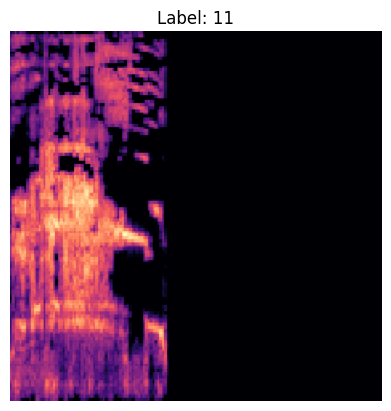

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE
batch_size = 32

# Split data into train+val and test (10% test)
train_val_paths, test_paths, train_val_labels, test_labels = train_test_split(
    paths, labels, test_size=0.1, random_state=42, stratify=labels
)

# Split train+val into train and val (10% of train_val as val)
train_paths, val_paths, train_labels, val_labels = train_test_split(
    train_val_paths, train_val_labels, test_size=0.1, random_state=42, stratify=train_val_labels
)

# Create datasets
def load_and_preprocess(path, label):
    return preprocess_image(path), label

train_ds = tf.data.Dataset.from_tensor_slices((train_paths, train_labels))
train_ds = train_ds.map(load_and_preprocess, num_parallel_calls=AUTOTUNE)
train_ds = train_ds.shuffle(1024).batch(batch_size).prefetch(AUTOTUNE)

val_ds = tf.data.Dataset.from_tensor_slices((val_paths, val_labels))
val_ds = val_ds.map(load_and_preprocess, num_parallel_calls=AUTOTUNE)
val_ds = val_ds.batch(batch_size).prefetch(AUTOTUNE)

test_ds = tf.data.Dataset.from_tensor_slices((test_paths, test_labels))
test_ds = test_ds.map(load_and_preprocess, num_parallel_calls=AUTOTUNE)
test_ds = test_ds.batch(batch_size).prefetch(AUTOTUNE)

print("Dataset sizes:")
print(f"Train: {len(train_paths)} images")
print(f"Validation: {len(val_paths)} images")
print(f"Test: {len(test_paths)} images")
print("--------------------------------------------------")
print("Train labels sample:", train_labels[:10])
print("Validation labels sample:", val_labels[:10])
print("Test labels sample:", test_labels[:10])

# Preview normalized image stats and visualization
for image_batch, label_batch in train_ds.take(1):
    # Print pixel value stats for first image in the batch
    image = image_batch[0]
    label = label_batch[0]
    print("Image dtype:", image.dtype)
    print("Min pixel value:", tf.reduce_min(image).numpy())
    print("Max pixel value:", tf.reduce_max(image).numpy())
    print("Label:", label.numpy())

    # Show the image
    plt.imshow(image.numpy())
    plt.title(f"Label: {label.numpy()}")
    plt.axis('off')
    plt.show()

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(231, 232, 4)),
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom(0.1),
])

# **CNN Model Setup**

In [ ]:
# Model parameters
weight_decay = 1e-4
num_classes = df['class'].nunique()

# Model definition
model = Sequential([
    data_augmentation  # Augmentation applied only during training
])

# Convolutional Blocks
model.add(Conv2D(32, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay), input_shape=(231,232,4)))
model.add(BatchNormalization())
model.add(Conv2D(32, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(MaxPooling2D((2,2)))
model.add(Dropout(0.2))

model.add(Conv2D(64, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(Conv2D(64, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(MaxPooling2D((2,2)))
model.add(Dropout(0.3))

model.add(Conv2D(128, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(Conv2D(128, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(MaxPooling2D((2,2)))
model.add(Dropout(0.4))

model.add(Conv2D(256, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(Conv2D(256, (3,3), padding='same', activation='relu', kernel_regularizer=l2(weight_decay)))
model.add(BatchNormalization())
model.add(MaxPooling2D((2,2)))
model.add(Dropout(0.5))

# Final layers
model.add(Flatten())
model.add(Dense(num_classes, activation='softmax'))

model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 231, 232, 4)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 231, 232, 32)   │         1,184 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 231, 232, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 231, 232, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 231, 232, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 115, 116, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 115, 116, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 115, 116, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 115, 116, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 115, 116, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 115, 116, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 57, 58, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 57, 58, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 57, 58, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 57, 58, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 57, 58, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 57, 58, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 28, 29, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 28, 29, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 28, 29, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 28, 29, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 1,828,685 (6.98 MB)

 Trainable params: 1,826,765 (6.97 MB)

 Non-trainable params: 1,920 (7.50 KB)

# **Model Training**

In [ ]:
# Training hyperparameters
epochs = 50
learning_rate = 0.0005

# Compile
optimizer = Adam(learning_rate=learning_rate)
model.compile( optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Callbacks
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=1e-5, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=40, restore_best_weights=True, verbose=1)

# Train
history = model.fit(train_ds, validation_data=val_ds, epochs=epochs, callbacks=[reduce_lr, early_stopping], verbose=1)

Epoch 1/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 40s 444ms/step - accuracy: 0.1176 - loss: 11.4377 - val_accuracy: 0.0748 - val_loss: 3.4503 - learning_rate: 5.0000e-04
Epoch 2/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 18s 353ms/step - accuracy: 0.2662 - loss: 5.6896 - val_accuracy: 0.0748 - val_loss: 4.4554 - learning_rate: 5.0000e-04
Epoch 3/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 16s 335ms/step - accuracy: 0.3273 - loss: 4.6056 - val_accuracy: 0.0884 - val_loss: 3.5594 - learning_rate: 5.0000e-04
Epoch 4/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 20s 338ms/step - accuracy: 0.3256 - loss: 4.7439 - val_accuracy: 0.0952 - val_loss: 5.0493 - learning_rate: 5.0000e-04
Epoch 5/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 20s 340ms/step - accuracy: 0.4046 - loss: 4.9601 - val_accuracy: 0.1020 - val_loss: 5.2727 - learning_rate: 5.0000e-04
Epoch 6/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 21s 339ms/step - accuracy: 0.3330 - loss: 4.5942 - val_accuracy: 0.0680 - val_loss: 8.4822 - learning_rate: 5.0000e-04
Epoch 7/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 20s 346ms/step - ac

# **Model Evaluation**

In [ ]:
# Evaluate on test dataset
test_loss, test_accuracy = model.evaluate(test_ds, verbose=1)
print(f"Test Accuracy: {test_accuracy:.4f}")

# Predict probabilities
y_pred_probs = model.predict(test_ds)
y_pred = np.argmax(y_pred_probs, axis=1)

# True labels (same order as test_ds batching)
y_true = np.concatenate([y for x, y in test_ds], axis=0)

# Metrics
precision = precision_score(y_true, y_pred, average='macro')
recall = recall_score(y_true, y_pred, average='macro')
f1 = f1_score(y_true, y_pred, average='macro')

print(f"Precision: {precision:.4f}, Recall: {recall:.4f}, F1-score: {f1:.4f}")

# Optional: detailed report per class
print("\nClassification Report:")
print(classification_report(y_true, y_pred, target_names=le.classes_))

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.6002 - loss: 2.5068
Test Accuracy: 0.5828
6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 831ms/step
Precision: 0.7418, Recall: 0.5858, F1-score: 0.6143

Classification Report:
                precision    recall  f1-score   support

      Baby cry       0.92      0.92      0.92        12
      Chainsaw       0.80      0.62      0.70        13
    Clock tick       1.00      0.42      0.59        12
           Cow       1.00      0.54      0.70        13
           Dog       0.69      0.69      0.69        13
Fire crackling       0.86      0.50      0.63        12
          Frog       1.00      0.77      0.87        13
    Helicopter       0.75      0.46      0.57        13
 Person sneeze       0.26      1.00      0.41        12
           Pig       1.00      0.42      0.59        12
          Rain       0.07      0.08      0.07        13
       Rooster       0.90      0.75      0.82        12
     Sea waves       0.40      0.46      0.43        13

     

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.6002 - loss: 2.5068 
Test Accuracy: 0.5828
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 85ms/step

Classification Report:
                precision    recall  f1-score   support

      Baby cry       0.92      0.92      0.92        12
      Chainsaw       0.80      0.62      0.70        13
    Clock tick       1.00      0.42      0.59        12
           Cow       1.00      0.54      0.70        13
           Dog       0.69      0.69      0.69        13
Fire crackling       0.86      0.50      0.63        12
          Frog       1.00      0.77      0.87        13
    Helicopter       0.75      0.46      0.57        13
 Person sneeze       0.26      1.00      0.41        12
           Pig       1.00      0.42      0.59        12
          Rain       0.07      0.08      0.07        13
       Rooster       0.90      0.75      0.82        12
     Sea waves       0.40      0.46      0.43        13

      accuracy                           0.58       163
 

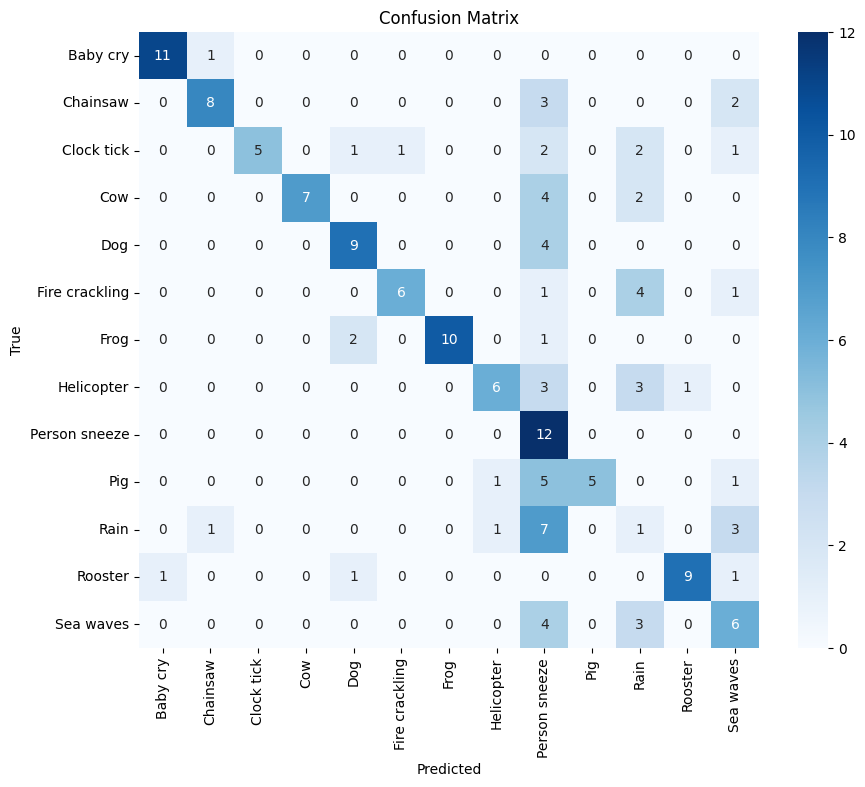

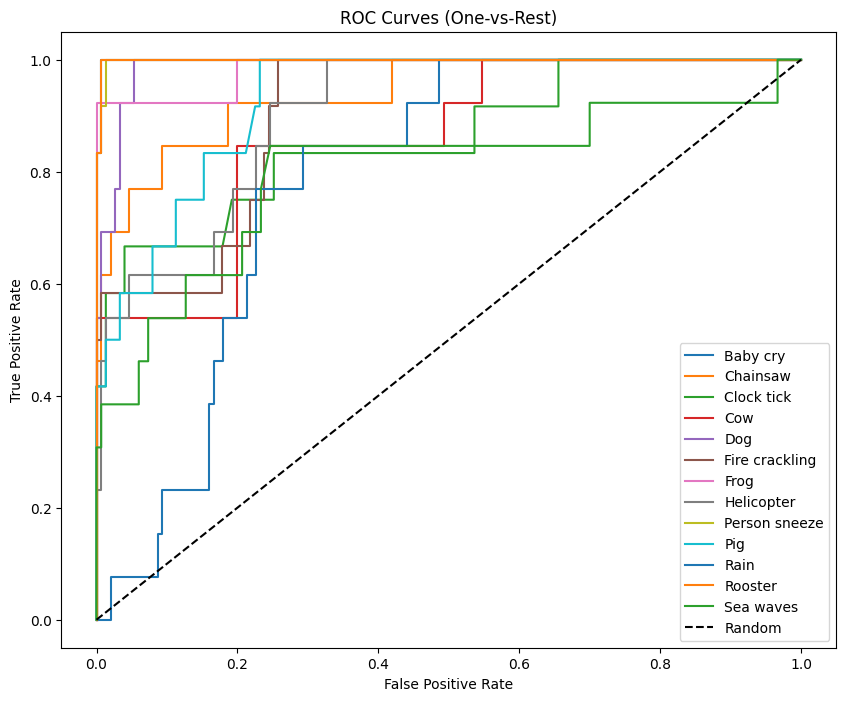

In [ ]:
# Evaluate model
test_loss, test_accuracy = model.evaluate(test_ds, verbose=1)
print(f"Test Accuracy: {test_accuracy:.4f}")

# Predictions
y_probs = model.predict(test_ds)  # shape: (num_samples, num_classes)
y_pred = np.argmax(y_probs, axis=1)

# True labels (extract from test_ds)
y_true = np.concatenate([y for _, y in test_ds], axis=0)

# Classification report
print("\nClassification Report:")
print(classification_report(y_true, y_pred, target_names=le.classes_))

# Confusion matrix
cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(10,8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=le.classes_, yticklabels=le.classes_)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

# ROC curve (multi-class, one-vs-rest)
y_true_bin = label_binarize(y_true, classes=np.arange(num_classes))  # binarized true labels

plt.figure(figsize=(10,8))
for i in range(num_classes):
    fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_probs[:, i])
    plt.plot(fpr, tpr, label=f"{le.classes_[i]}")
plt.plot([0,1],[0,1],'k--', label='Random')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curves (One-vs-Rest)")
plt.legend()
plt.show()

In [ ]:
# Predictions
y_probs = model.predict(test_ds)
y_pred = np.argmax(y_probs, axis=1)

# True labels
y_true = np.concatenate([y for _, y in test_ds], axis=0)

# Metrics per class
precision, recall, f1, support = precision_recall_fscore_support(
    y_true, y_pred, average=None, labels=np.arange(num_classes)
)

df_metrics = pd.DataFrame({
    'Class': le.classes_,   # use actual class names instead of 0,1,2,3
    'Precision': precision,
    'Recall': recall,
    'F1-score': f1,
    'Support': support
})

# Sort by F1-score ascending
df_metrics_sorted = df_metrics.sort_values(by='F1-score')
print(df_metrics_sorted)

# Macro averages
precision_macro, recall_macro, f1_macro, _ = precision_recall_fscore_support(
    y_true, y_pred, average='macro'
)
print(f"\nMacro Avg -> Precision: {precision_macro:.4f}, Recall: {recall_macro:.4f}, F1-score: {f1_macro:.4f}")

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
             Class  Precision    Recall  F1-score  Support
10            Rain   0.066667  0.076923  0.071429       13
8    Person sneeze   0.260870  1.000000  0.413793       12
12       Sea waves   0.400000  0.461538  0.428571       13
7       Helicopter   0.750000  0.461538  0.571429       13
9              Pig   1.000000  0.416667  0.588235       12
2       Clock tick   1.000000  0.416667  0.588235       12
5   Fire crackling   0.857143  0.500000  0.631579       12
4              Dog   0.692308  0.692308  0.692308       13
1         Chainsaw   0.800000  0.615385  0.695652       13
3              Cow   1.000000  0.538462  0.700000       13
11         Rooster   0.900000  0.750000  0.818182       12
6             Frog   1.000000  0.769231  0.869565       13
0         Baby cry   0.916667  0.916667  0.916667       12

Macro Avg -> Precision: 0.7418, Recall: 0.5858, F1-score: 0.6143


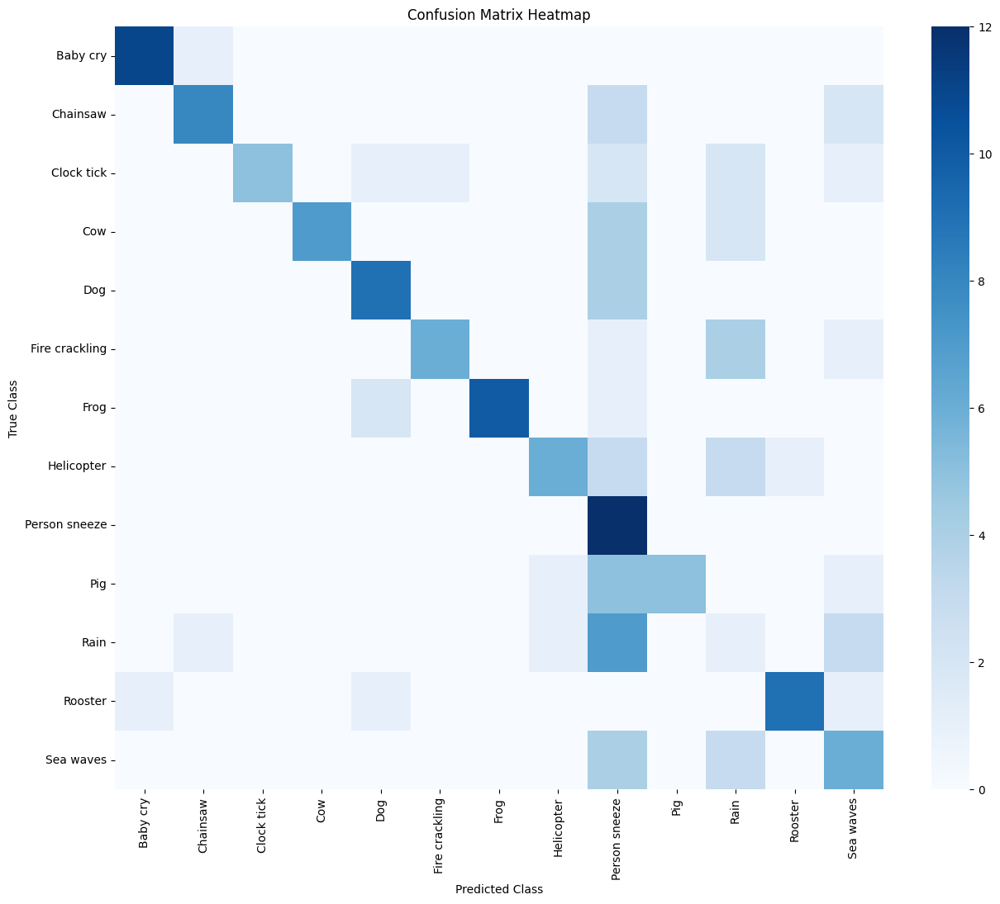

In [ ]:
# Confusion matrix (no annotations, just intensity heatmap)
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(15,12))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues',
            xticklabels=le.classes_, yticklabels=le.classes_)
plt.xlabel("Predicted Class")
plt.ylabel("True Class")
plt.title("Confusion Matrix Heatmap")
plt.show()

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 69ms/step


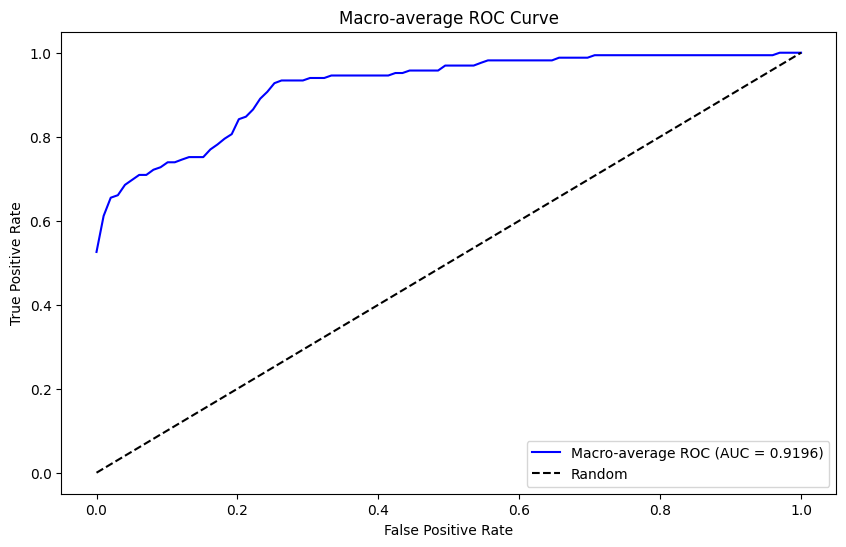

In [ ]:
# Binarize true labels
y_test_bin = label_binarize(y_true, classes=np.arange(num_classes))

# Predict class probabilities
y_probs = model.predict(test_ds)

# Compute macro-average ROC
all_fpr = np.linspace(0, 1, 100)
mean_tpr = 0

for i in range(num_classes):
    fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_probs[:, i])
    mean_tpr += np.interp(all_fpr, fpr, tpr)

mean_tpr /= num_classes
roc_auc = auc(all_fpr, mean_tpr)

# Plot
plt.figure(figsize=(10,6))
plt.plot(all_fpr, mean_tpr, color='b',
         label=f'Macro-average ROC (AUC = {roc_auc:.4f})')
plt.plot([0,1],[0,1],'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Macro-average ROC Curve')
plt.legend()
plt.show()

# **Model Save for Reproducability**

In [ ]:
model.save("Audio_Model_Classification.h5")
files.download("Audio_Model_Classification.h5")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
drive.mount('/content/drive')
!cp -r /content/spectrograms /content/drive/MyDrive/spectrograms_v2

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
model_load = load_model('/content/drive/MyDrive/Models/Audio_Model_Classification.h5') #Make sure the model in Google Drive first

model_load.summary()

In [ ]:
# Zip the spectrograms folder
shutil.make_archive("/content/spectrograms", 'zip', "/content/spectrograms")

# Download the zipped folder
files.download("/content/spectrograms.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>